 # Sprawozdanie 3: Symulowane wyżarzanie

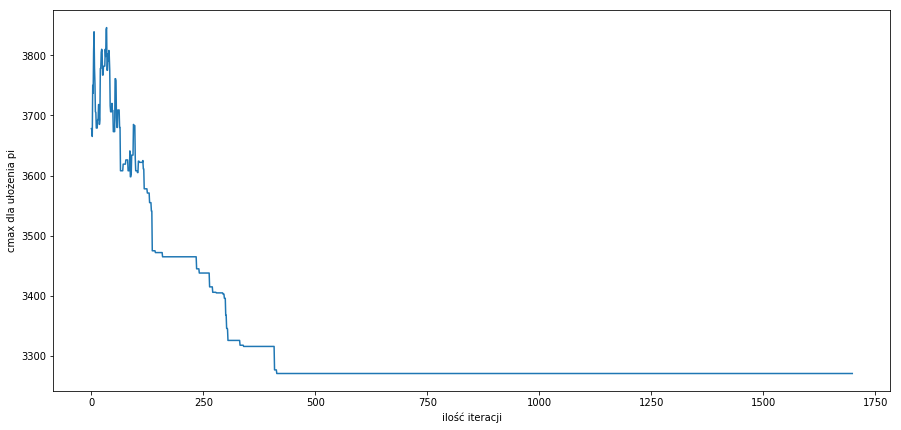

In [1]:
from schedule import Schedule
from simulated_annealing import *
import matplotlib.pyplot as plt
%matplotlib inline
from random import seed
seed(370773)
plt.rcParams['figure.figsize'] = [15, 7]

schdl = Schedule()
schdl.load_from_file("ta47")

u=0.98
temp=100
iterations=1700
schedule_lenght = len(schdl.joblist)
steps1 = []
for i in range(iterations):
    tmp_schdl = schdl.__copy__()
    swap(tmp_schdl, schedule_lenght)
    if tmp_schdl.cmax() < schdl.cmax():
        schdl = tmp_schdl
    else:
        prob = math.exp((schdl.cmax() - tmp_schdl.cmax())/temp)
        if random() < prob:
            schdl = tmp_schdl

    steps1.append(schdl.cmax())
    temp = u * temp


plt.xlabel("ilość iteracji")
plt.ylabel("cmax dla ułożenia pi")
plt.plot(steps1)
plt.show()

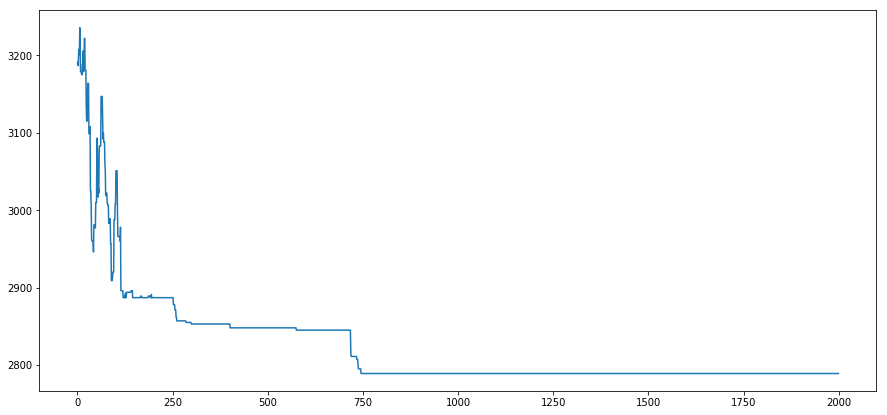

In [2]:
from schedule import Schedule
from simulated_annealing import *
from random import seed
import matplotlib.pyplot as plt
%matplotlib inline
seed(370773)
plt.rcParams['figure.figsize'] = [15, 7]



schdl = Schedule()
schdl.load_from_file("ta40")

u=0.98
temp=100
iterations=2000
schedule_lenght = len(schdl.joblist)
steps = []
for i in range(iterations):
    tmp_schdl = schdl.__copy__()
    random_insert(tmp_schdl, schedule_lenght)
    if tmp_schdl.cmax() < schdl.cmax():
        schdl = tmp_schdl
    else:
        prob = math.exp((schdl.cmax() - tmp_schdl.cmax())/temp)
        if random() < prob:
            schdl = tmp_schdl

    steps.append(schdl.cmax())
    temp = u * temp


plt.plot(steps)
plt.show()

# Porównanie insert i swap

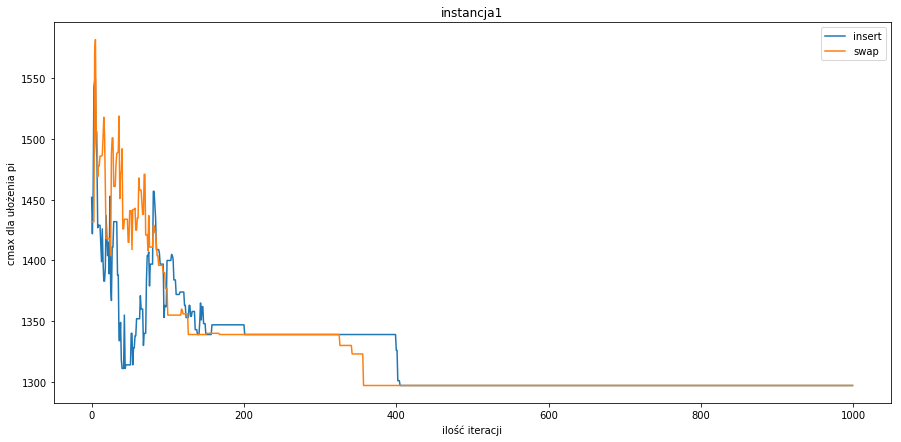

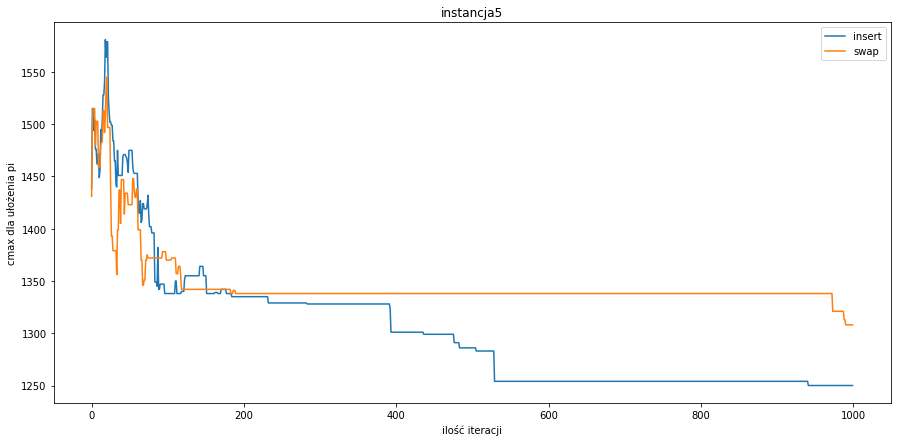

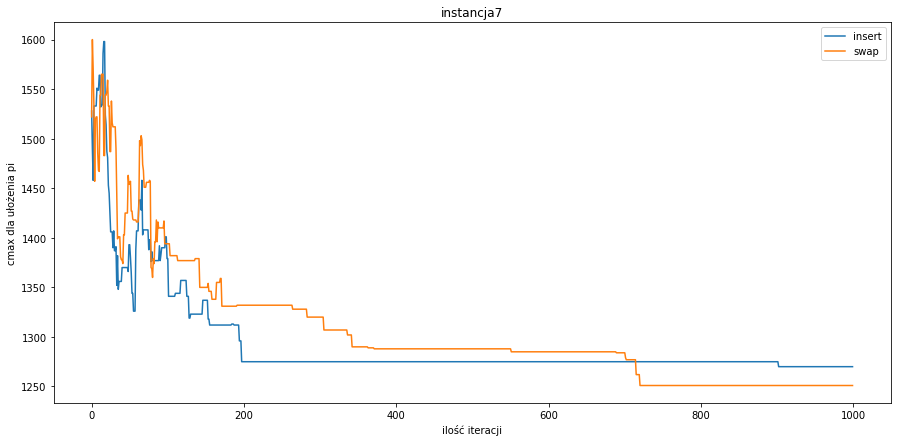

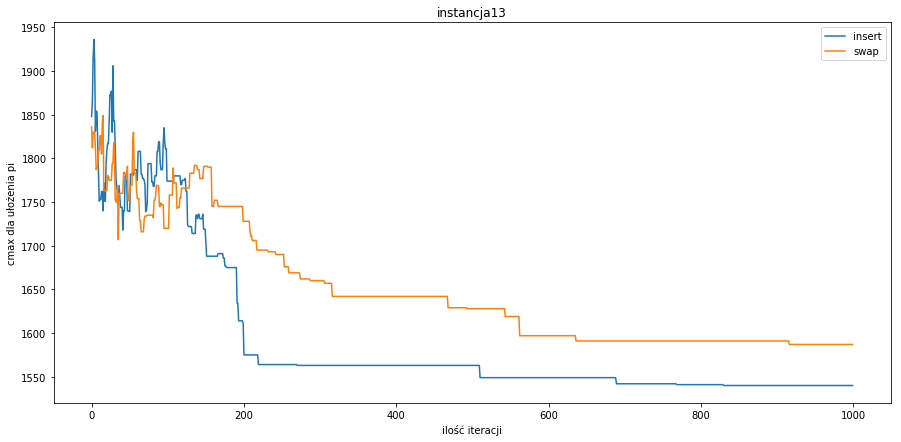

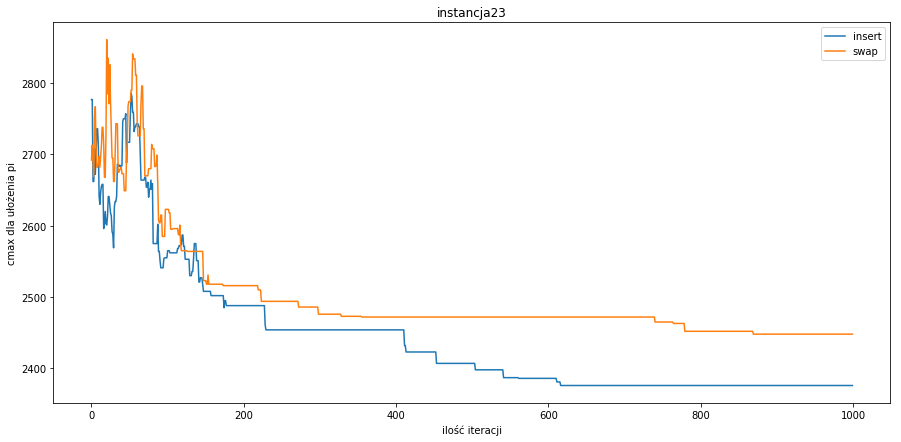

...

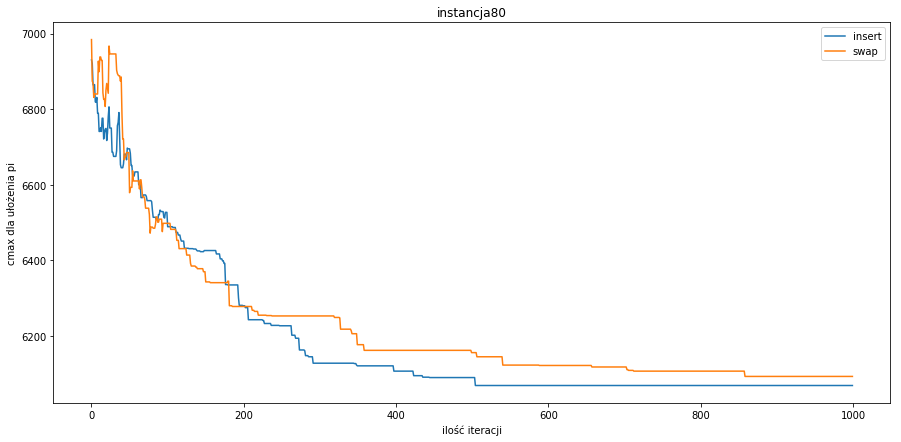

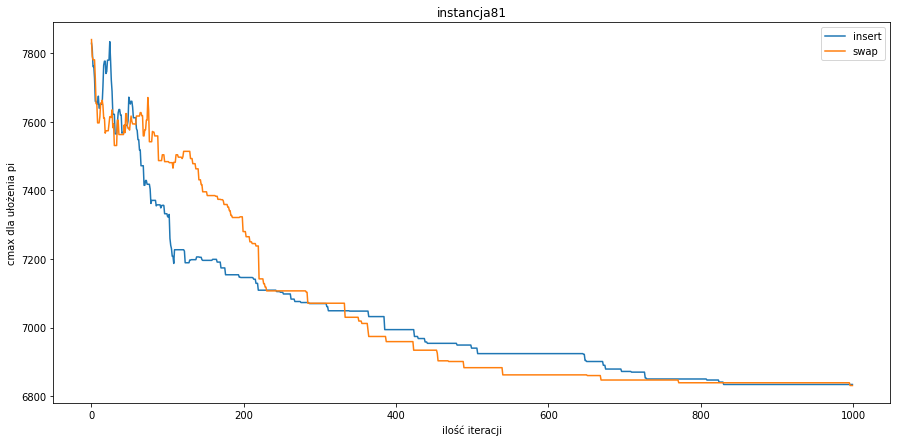

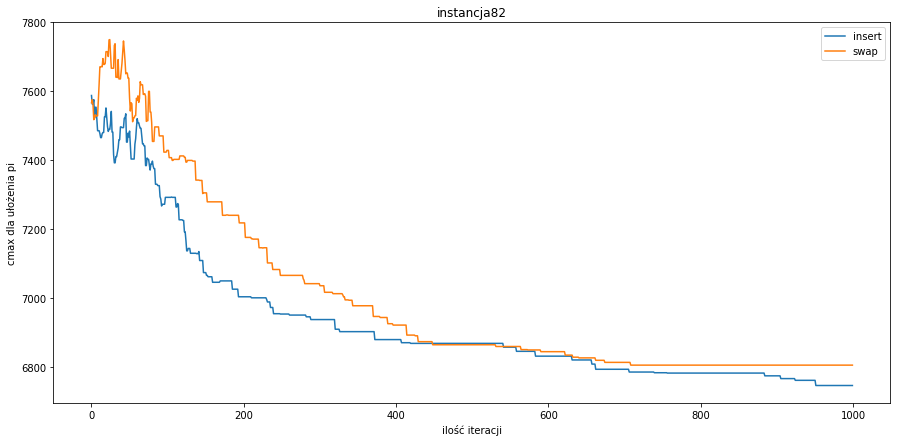

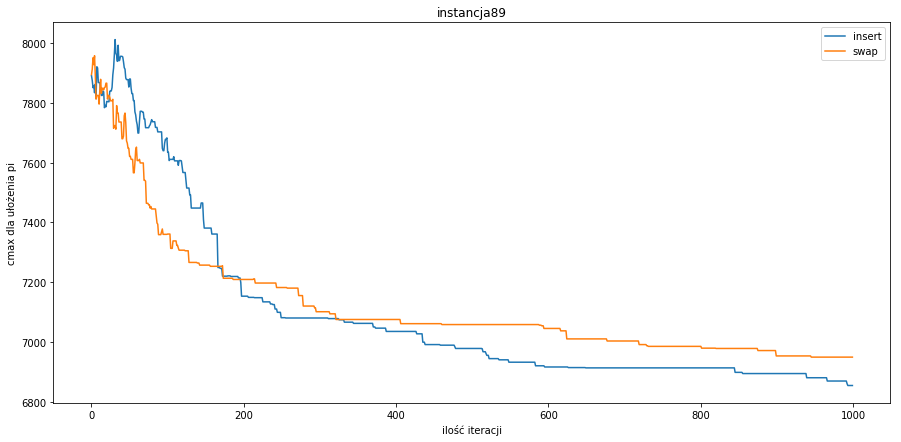

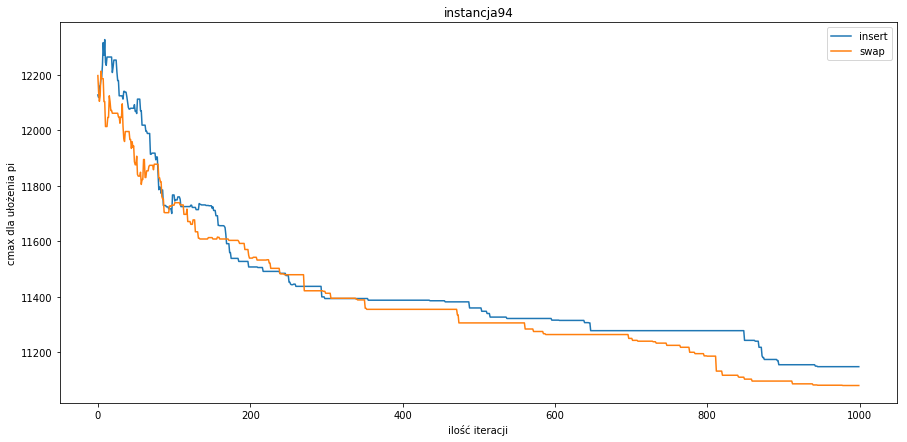

Średnia róznica wynosiła: -0.897%


In [3]:
from simulated_annealing import annealing
from random import randint, seed
from schedule import Schedule
import time
import plotly.plotly as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot
from plotly.graph_objs import *
init_notebook_mode()

seed(370773)

rnd_instances = []
for i in range(5):
    rnd_instances.append(randint(1,20))
for i in range(5):
    rnd_instances.append(randint(21,50))
for i in range(5):
    rnd_instances.append(randint(51,80))
for i in range(5):
    rnd_instances.append(randint(81,100))


rnd_instances = list(set(rnd_instances))
rnd_instances.sort()

schdl = Schedule()

iterations_tab = [1000]
instances = []
iterations = []
swap_cmax = []
insert_cmax = []
dif = []
tab_data = [instances, iterations, swap_cmax, insert_cmax, dif]

desc = ['Instancja', 'Liczba iteracji', 'Cmax swap', 'Cmax insert', 'Różnica']


for instance in rnd_instances:
    for i in range(len(iterations_tab)):
        instances.append(instance)
        schdl.load_from_file("ta" + str(instance))
        cmax, inst = annealing(schdl, iterations=iterations_tab[i], move="insert")
        insert_cmax.append(cmax)

        schdl.load_from_file("ta" + str(instance))
        cmax, swp = annealing(schdl, iterations=iterations_tab[i], move="swap")
        swap_cmax.append(cmax)
        dif.append(str("{0:.6f}".format(100*(insert_cmax[-1] - swap_cmax[-1])/swap_cmax[-1])))
        iterations.append(iterations_tab[i])
        
    plt.title("instancja"+str(instance))
    plt.xlabel("ilość iteracji")
    plt.ylabel("cmax dla ułożenia pi")
    plt.plot(inst, label="insert")  
    plt.plot(swp, label="swap")
    plt.legend()
    
    plt.show()
    
difs = [float(i) for i in dif]
avg = sum(difs)/len(difs) 
trace = go.Table(
    header=dict(values=desc),
    cells=dict(values=tab_data))

layout = Layout(
    showlegend=False,
    height=900,
    width=700,
    )

data = [trace]
fig = dict(data=data, layout=layout)
iplot(fig)
print("Średnia róznica wynosiła: " + str("{0:.3f}".format(avg))+"%")

Nie udało się znaleźć żadnej zależności między wyborem ruchu typu insert, a wyborem ruchu typu swap.

# Badania dotyczące współczynnika wychładzania

Przeprowadzono badania dla czterech różnych współczynników wychładzania, aby porównać wyniki i wywnioskować, który z nich gwarantuje lepszy rezultat.

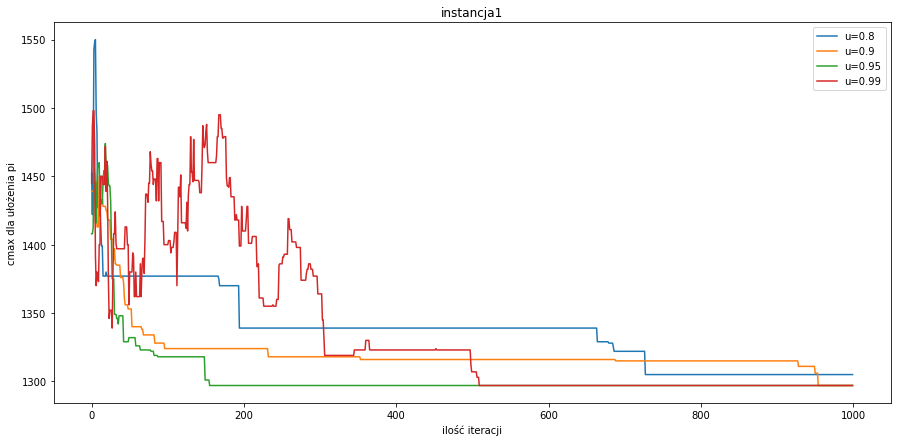

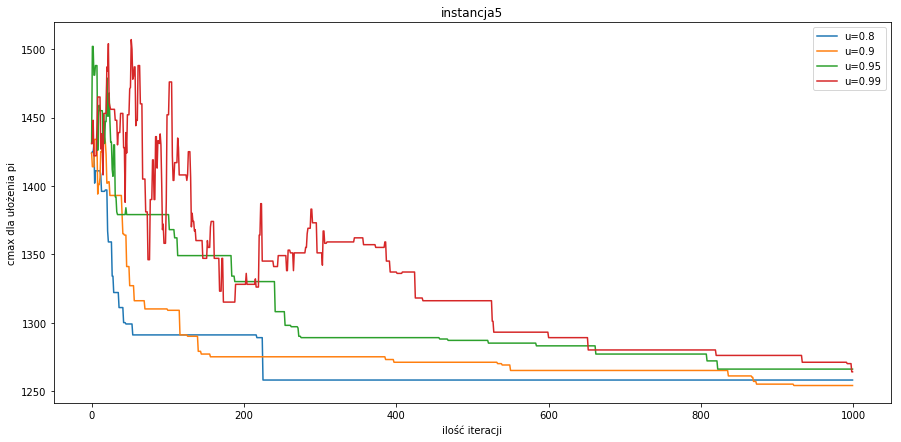

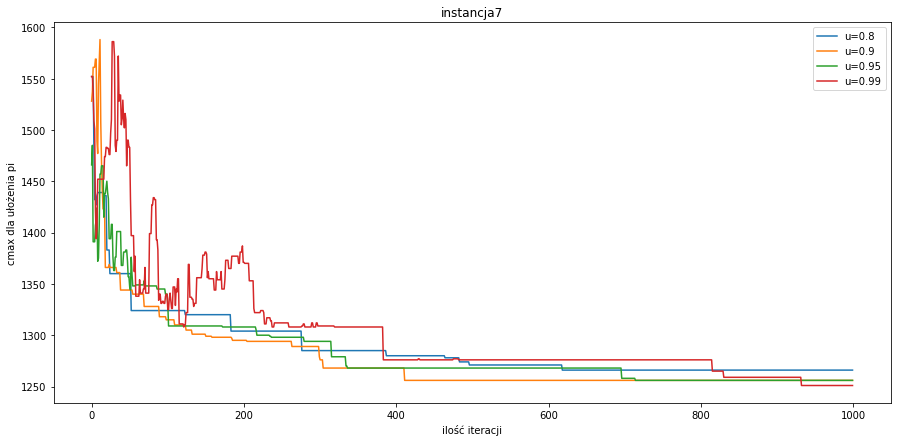

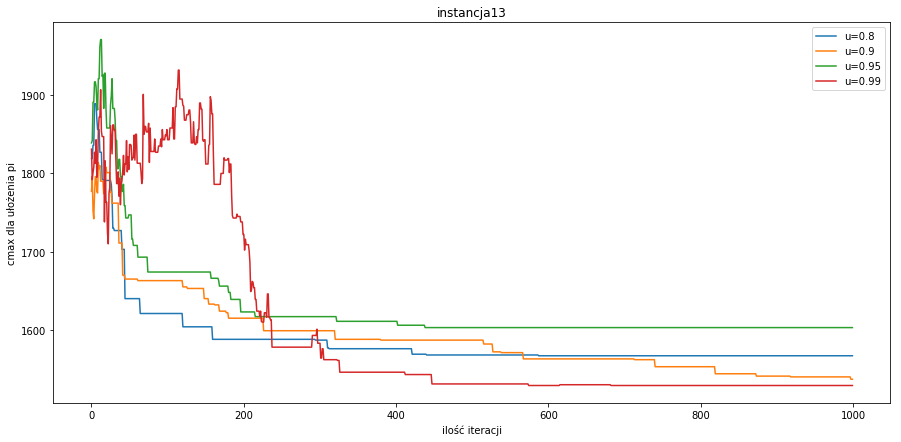

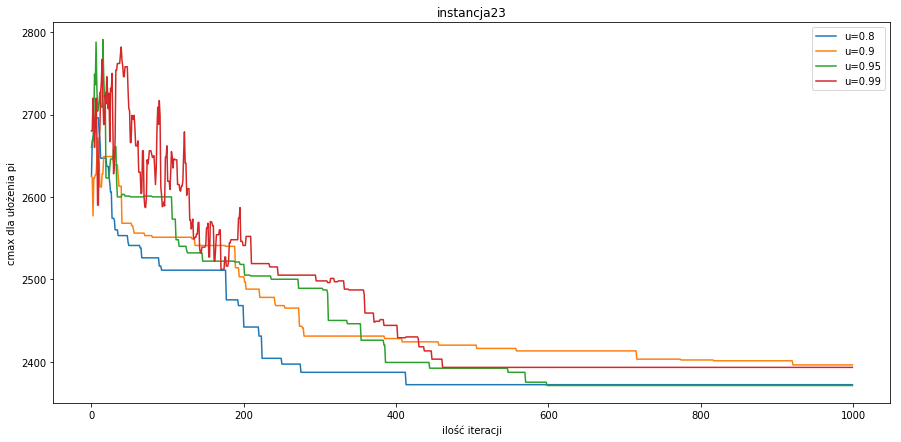

...

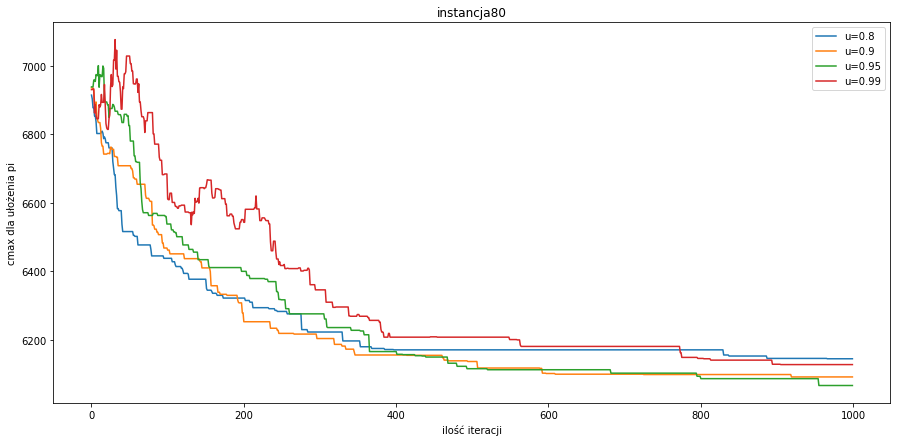

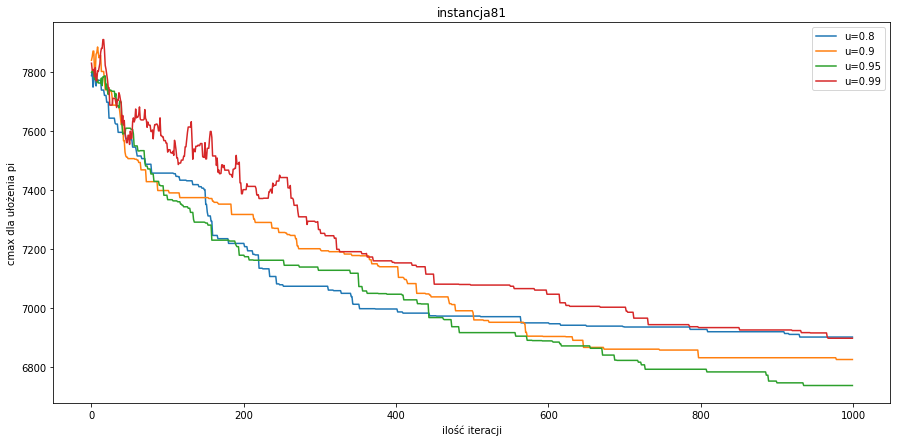

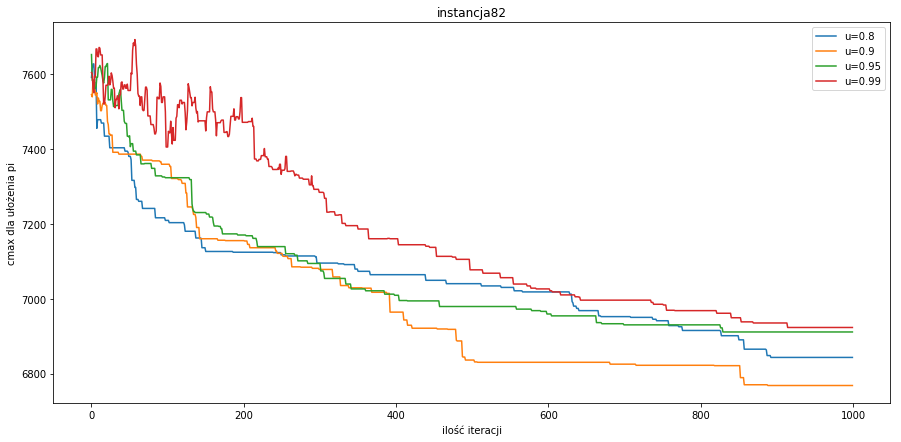

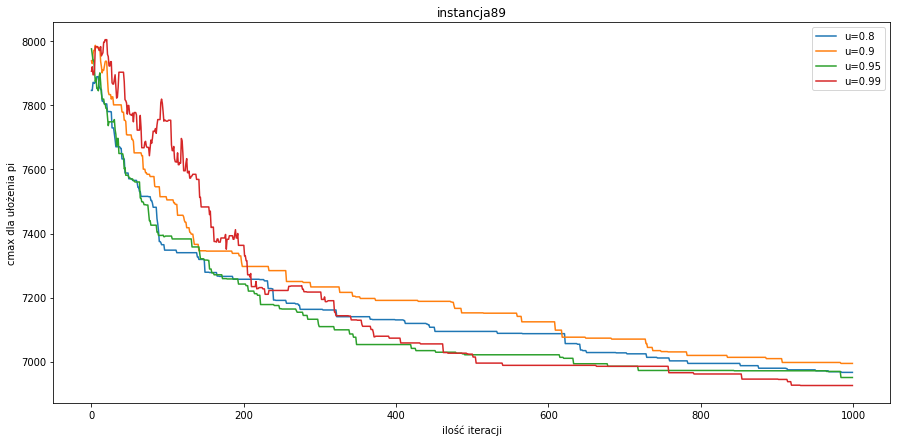

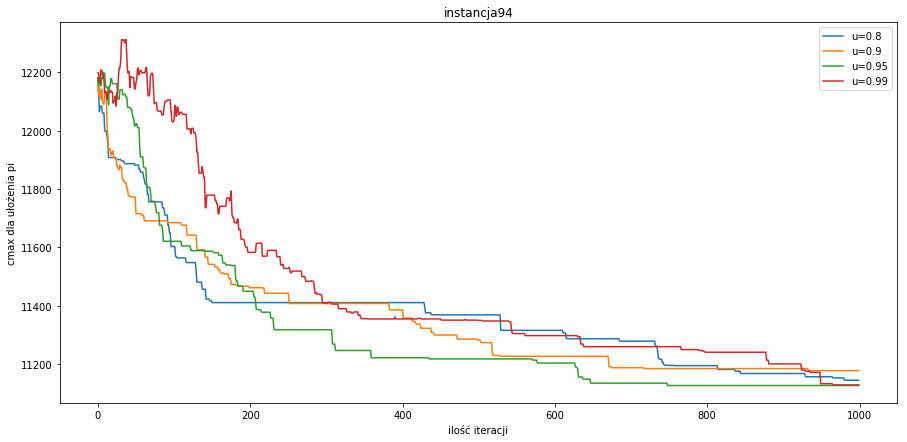

Liczba najmniejszych Cmax dla:
u = 0.8 -> 65
u = 0.9 -> 34
u = 0.95 -> 35
u = 0.99 -> 15


In [4]:
import time
from schedule import Schedule
from simulated_annealing import annealing
from random import randint, seed
import plotly.plotly as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot
from plotly.graph_objs import *
init_notebook_mode()
 

seed(370773)

rnd_instances = []
for i in range(5):
    rnd_instances.append(randint(1,20))
for i in range(5):
    rnd_instances.append(randint(21,50))
for i in range(5):
    rnd_instances.append(randint(51,80))
for i in range(5):
    rnd_instances.append(randint(81,100))


rnd_instances = list(set(rnd_instances))
rnd_instances.sort()
    
schdl = Schedule()
u1 = 0
u2 = 0
u3 = 0
u4 = 0
iterations_tab = [5, 10, 25, 50, 100, 250, 500, 1000]
iterations = []
instances = []
u1_cmax = []
u2_cmax = []
u3_cmax = []
u4_cmax = []
min_cmax = []
tab_data = [instances, iterations, u1_cmax, u2_cmax, u3_cmax, u4_cmax]

desc = ['Instancja', 'Liczba iteracji', 'Cmax dla u=0.8', 'Cmax dla u=0.9', 'Cmax dla u=0.95', 'Cmax dla u=0.99']

for instance in rnd_instances:
    plt.rcParams['figure.figsize'] = [15, 7]

    schdl.load_from_file("ta" + str(instance))
    cmax, cmax_tab8 = annealing(schdl, u=0.8, iterations=iterations_tab[-1], move="insert")
    plt.plot(cmax_tab8, label="u=0.8")

    schdl.load_from_file("ta" + str(instance))
    cmax, cmax_tab9 = annealing(schdl, u=0.9, iterations=iterations_tab[-1], move="insert")
    plt.plot(cmax_tab9, label="u=0.9")

    schdl.load_from_file("ta" + str(instance))
    cmax, cmax_tab95 = annealing(schdl, u=0.95, iterations=iterations_tab[-1], move="insert")
    plt.plot(cmax_tab95, label="u=0.95")

    schdl.load_from_file("ta" + str(instance))
    cmax, cmax_tab99 = annealing(schdl, u=0.99, iterations=iterations_tab[-1], move="insert")
    plt.plot(cmax_tab99, label="u=0.99")

    for iterations_num in iterations_tab:
        u1_cmax.append(cmax_tab8[iterations_num-1])
        u2_cmax.append(cmax_tab9[iterations_num-1])
        u3_cmax.append(cmax_tab95[iterations_num-1])
        u4_cmax.append(cmax_tab99[iterations_num-1])
        iterations.append(iterations_num)
        instances.append(instance)        
        
        for k in range(len(instances)):
            minim = min(u1_cmax[k],u2_cmax[k],u3_cmax[k],u4_cmax[k])

        min_cmax.append(minim)
            
    plt.title("instancja"+str(instance))
    plt.xlabel("ilość iteracji")
    plt.ylabel("cmax dla ułożenia pi")
    plt.legend()
    
    plt.show()



        
for k in range(len(instances)):
    if u1_cmax[k] == min_cmax[k]:
        u1 = u1+1
    if u2_cmax[k] == min_cmax[k]:
        u2 = u2+1
    if u3_cmax[k] == min_cmax[k]:
        u3 = u3+1
    if u4_cmax[k] == min_cmax[k]:
        u4 = u4+1
        
trace = go.Table(
    header=dict(values=desc),
    cells=dict(values=tab_data,
               fill = dict(color=['rgb(245,245,245)','rgb(245,245,245)',#unique color for the first column
                                            
                                ['rgba(0,250,0, 0.8)' if u1_cmax[k]==min_cmax[k] else 'rgb(245,245,245)' for k in range(len(instances))],
                                ['rgba(0,250,0, 0.8)' if u2_cmax[k]==min_cmax[k] else 'rgb(245,245,245)' for k in range(len(instances))],
                                ['rgba(0,250,0, 0.8)' if u3_cmax[k]==min_cmax[k] else 'rgb(245,245,245)' for k in range(len(instances))],
                                ['rgba(0,250,0, 0.8)' if u4_cmax[k]==min_cmax[k] else 'rgb(245,245,245)' for k in range(len(instances))] ]
                          )
              )
)



layout = Layout(
    showlegend=False,
    height=900,
    width=700,
    )

data = [trace]
fig = dict(data=data, layout=layout)
iplot(fig)

print("Liczba najmniejszych Cmax dla:")
print("u = 0.8 -> " +str(u1))
print("u = 0.9 -> " +str(u2))
print("u = 0.95 -> " +str(u3))
print("u = 0.99 -> " +str(u4))

Najlepsze wyniki uzyskano dla współczynnika wychładzania równego 0.8, ponieważ podczas testowania najwięcej razy zwrócił Cmax o wartości najmniejszej ze wszystkich czterech. Im większy współczynnik, tym skuteczność znajdowania optymalnego rozwiązania była mniejsza. Dla największego współczynnika wartość Cmax okazała się najmniejszą w nielicznych przypadkach, natomiast o wiele lepiej wyglądała dla współczynników równych 0.8 oraz 0.9. Przy większej liczbie iteracji współczynnik 0.99 prawie nigdy nie był najlepszym, ale dla mniejszej liczby iteracji wyniki były bardziej różnorodne.

# Dobór temperatury początkowej

Przeprowadzono badania dla czterech różnych temperatur, aby porównać wyniki i wywnioskować, która z nich gwarantuje lepszy rezultat.

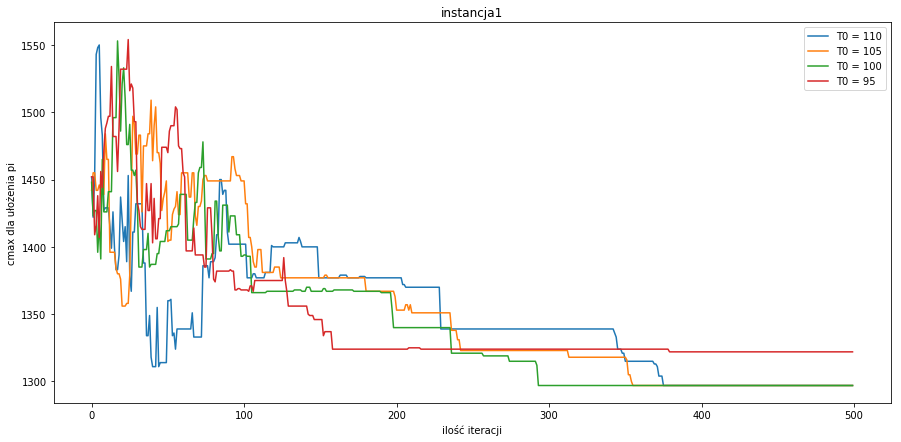

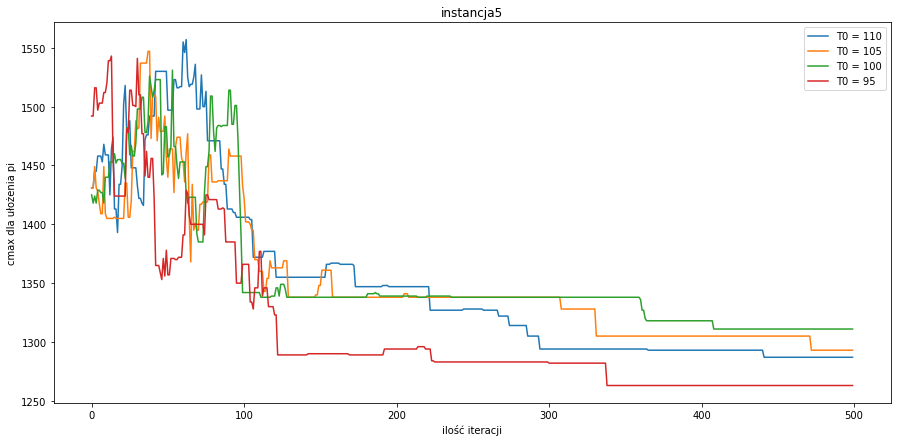

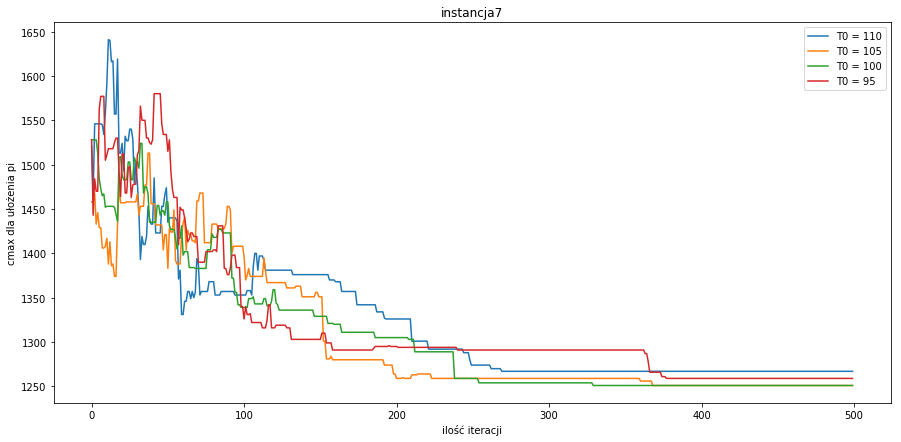

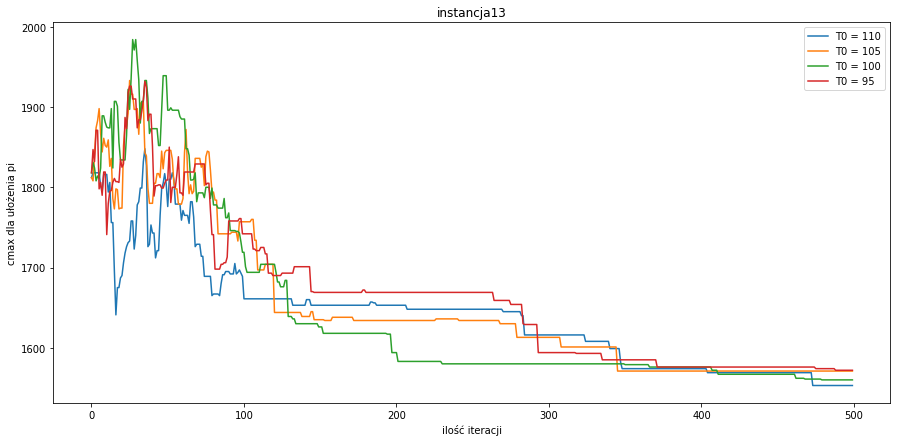

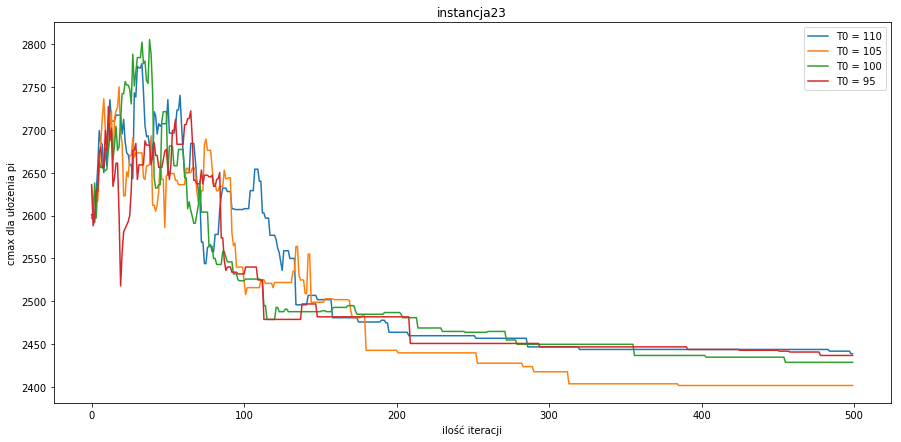

...

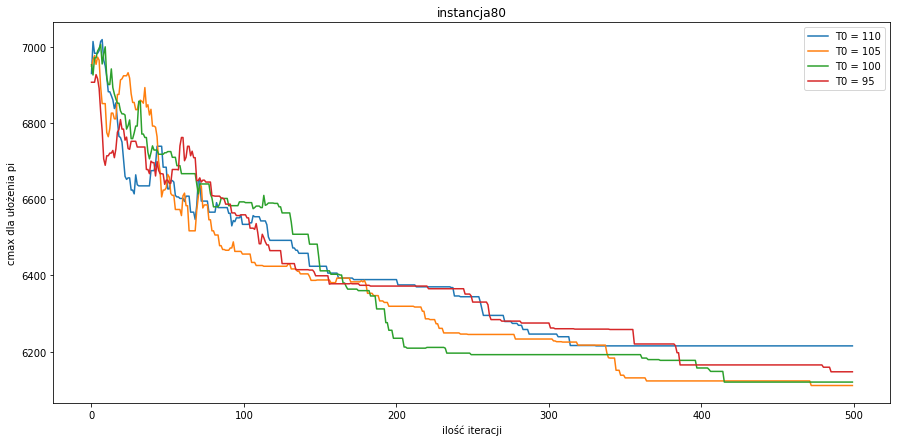

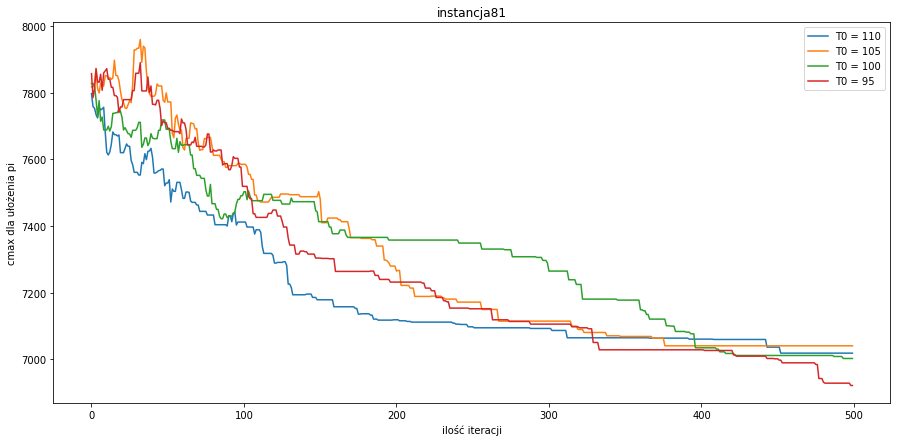

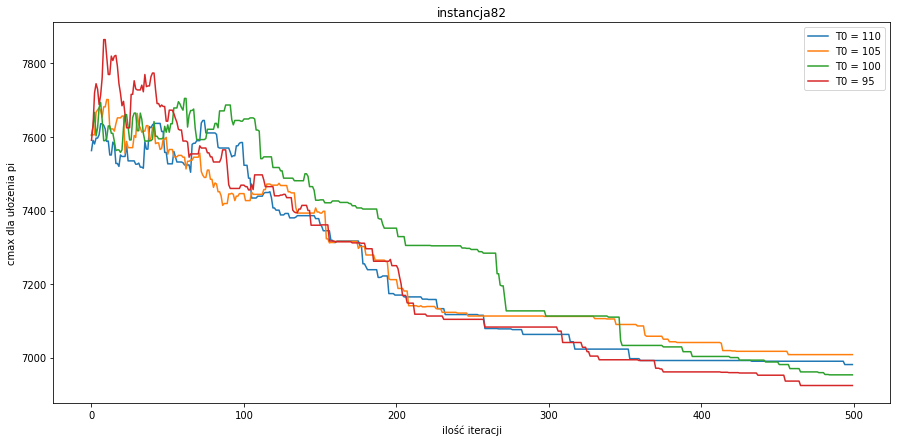

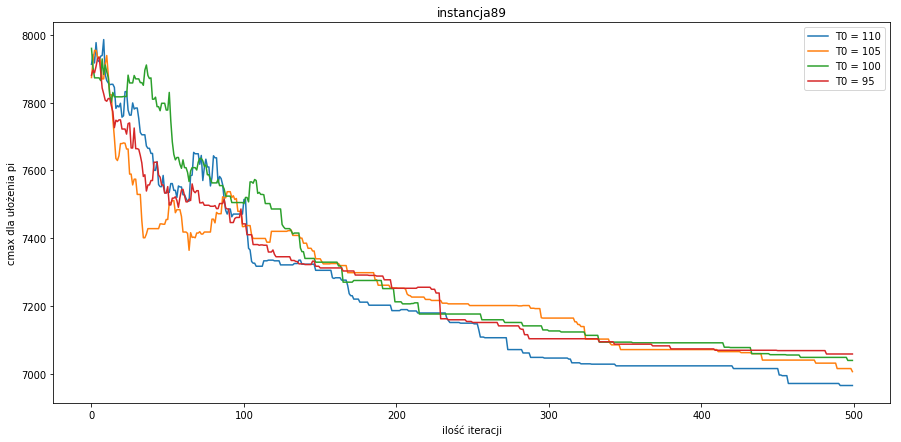

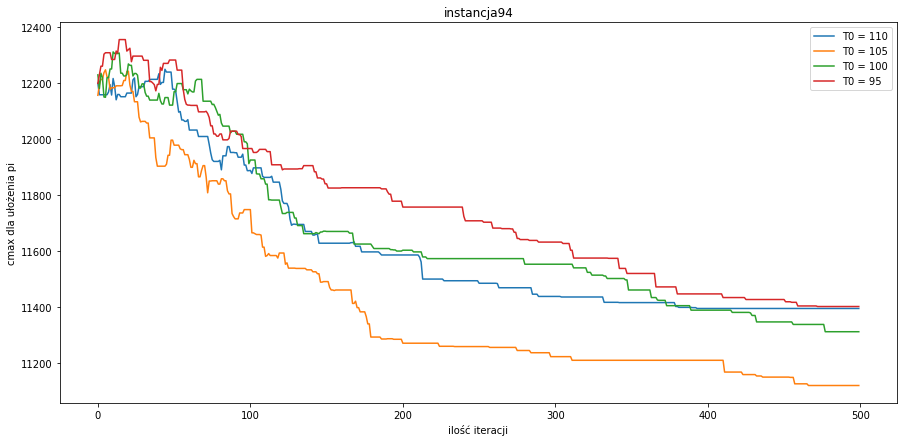

Liczba najmniejszych wartości Cmax dla:
Temperatury 1 -> 27
Temperatury 2 -> 37
Temperatury 3 -> 28
Temperatury 4 -> 20


In [5]:
import time
from random import randint, seed
from schedule import Schedule
from simulated_annealing import annealing
import plotly.plotly as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot
from plotly.graph_objs import *
init_notebook_mode()
 
    
seed(370773)

rnd_instances = []
for i in range(5):
    rnd_instances.append(randint(1,20))
for i in range(5):
    rnd_instances.append(randint(21,50))
for i in range(5):
    rnd_instances.append(randint(51,80))
for i in range(5):
    rnd_instances.append(randint(81,100))


rnd_instances = list(set(rnd_instances))
rnd_instances.sort()
    
schdl = Schedule()

iterations_tab = [5, 20, 50, 100, 200, 500]
iterations = []
instances = []
temperatures_tab = []
#temperatures = []
for tem in range(110,90,-5):
    temperatures_tab.append(tem)
t1 = 0
t2 = 0
t3 = 0
t4 = 0
t1_cmax = []
t2_cmax = []
t3_cmax = []
t4_cmax = []
min_cmax = []
tab_data = [instances, iterations, t1_cmax, t2_cmax, t3_cmax, t4_cmax]
desc = ['Instancja', 'Liczba iteracji', 'Temperatura 110', 'Temperatura 105', 'Temperatura 100', 'Temperatura 95']

for instance in rnd_instances:

        schdl.load_from_file("ta" + str(instance))
        cmax, temp1 = annealing(schdl, temp=temperatures_tab[0], iterations=iterations_tab[-1], move="insert")

        schdl.load_from_file("ta" + str(instance))
        cmax, temp2 = annealing(schdl, temp=temperatures_tab[1], iterations=iterations_tab[-1], move="insert")

        schdl.load_from_file("ta" + str(instance))
        cmax, temp3 = annealing(schdl, temp=temperatures_tab[2], iterations=iterations_tab[-1], move="insert")

        schdl.load_from_file("ta" + str(instance))
        cmax, temp4 = annealing(schdl, temp=temperatures_tab[3], iterations=iterations_tab[-1], move="insert")




        plt.title("instancja"+str(instance))
        plt.xlabel("ilość iteracji")
        plt.ylabel("cmax dla ułożenia pi")
        plt.plot(temp1, label="T0 = "+str(temperatures_tab[0]))  
        plt.plot(temp2, label="T0 = "+str(temperatures_tab[1]))  
        plt.plot(temp3, label="T0 = "+str(temperatures_tab[2]))  
        plt.plot(temp4, label="T0 = "+str(temperatures_tab[3]))  
        plt.legend()

        plt.show()

        for iterations_num in iterations_tab:
            t1_cmax.append(temp1[iterations_num-1])
            t2_cmax.append(temp2[iterations_num-1])
            t3_cmax.append(temp3[iterations_num-1])
            t4_cmax.append(temp4[iterations_num-1])
            iterations.append(iterations_num)
            instances.append(instance)        
            
            for k in range(len(instances)):
                minim = min(t1_cmax[k],t2_cmax[k],t3_cmax[k],t4_cmax[k])

            min_cmax.append(minim)
            
                
            
            
            

for k in range(len(instances)):
    if t1_cmax[k] == min_cmax[k]:
        t1 = t1+1
    if t2_cmax[k] == min_cmax[k]:
        t2 = t2+1
    if t3_cmax[k] == min_cmax[k]:
        t3 = t3+1
    if t4_cmax[k] == min_cmax[k]:
        t4 = t4+1
        
trace = go.Table(
    header=dict(values=desc),
    cells=dict(values=tab_data,
               fill = dict(color=['rgb(245,245,245)','rgb(245,245,245)',#unique color for the first column
                                            
                                ['rgba(0,250,0, 0.8)' if t1_cmax[k]==min_cmax[k] else 'rgb(245,245,245)' for k in range(len(instances))],
                                ['rgba(0,250,0, 0.8)' if t2_cmax[k]==min_cmax[k] else 'rgb(245,245,245)' for k in range(len(instances))],
                                ['rgba(0,250,0, 0.8)' if t3_cmax[k]==min_cmax[k] else 'rgb(245,245,245)' for k in range(len(instances))],
                                ['rgba(0,250,0, 0.8)' if t4_cmax[k]==min_cmax[k] else 'rgb(245,245,245)' for k in range(len(instances))] ]
                          )
              )
)



layout = Layout(
    showlegend=False,
    height=900,
    width=700,
    )

data = [trace]
fig = dict(data=data, layout=layout)
iplot(fig)
            


print("Liczba najmniejszych wartości Cmax dla:")
print("Temperatury 1 -> " +str(t1))
print("Temperatury 2 -> " +str(t2))
print("Temperatury 3 -> " +str(t3))
print("Temperatury 4 -> " +str(t4))

Najlepsze wyniki uzyskano dla temperatury równej 100, jednak okazała się ona tylko minimalnie lepsza od temperatury równej 110. Ilość najmniejszych wartości Cmax dla obu tych temperatur była do siebie bardzo zbliżona i wyraźnie większa od optymalnych rezultatów dla pozostałych dwóch temperatur czyli 105 oraz 95.
Badania rozpoczęto od większego zakresu temperatur, który stopniowo zmniejszano w celu znalezienia jak najdokładniejszej wartości.

# Zastosowanie alternatywnej funkcji schładzania

Zastosowano drugą z funkcji schładzania, w której do obniżenia wartości temperatury wykorzystuje się iloraz aktualnej iteracji oraz maksymalnej liczby iteracji. 

In [6]:
import time
from random import seed, randint
from schedule import Schedule
from simulated_annealing import annealing
import plotly.plotly as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot
from plotly.graph_objs import *
init_notebook_mode()
 
    
seed(370773)

rnd_instances = []
for i in range(5):
    rnd_instances.append(randint(1,20))
for i in range(5):
    rnd_instances.append(randint(21,50))
for i in range(5):
    rnd_instances.append(randint(51,80))
for i in range(5):
    rnd_instances.append(randint(81,100))


rnd_instances = list(set(rnd_instances))
rnd_instances.sort()
    
schdl = Schedule()

iterations_tab = [5, 20, 50, 100, 200, 500]
iterations = []
instances = []
t1_cmax = []
ts_cmax = []
min_cmax = []
dif = []
tab_data = [instances, iterations, t1_cmax, ts_cmax, dif]
desc = ['Instancja', 'Liczba iteracji', 'Pierwotna funkcja', "Alternatywna funkcja", "Różnica (Pierwotna - Alternatywna)"]

for j in range(5):
    for instance in rnd_instances:
            instances.append(instance)
            
            schdl.load_from_file("ta" + str(instance))
            cmax, ept = annealing(schdl, iterations=iterations_tab[j], move="insert")
            t1_cmax.append(cmax)
            
            schdl.load_from_file("ta" + str(instance))
            cmax, ept = annealing(schdl, iterations=iterations_tab[j], move="insert", op="alternative")
            ts_cmax.append(cmax)
            
            for k in range(len(instances)):
                minim = min(t1_cmax[k], ts_cmax[k])
                roz=t1_cmax[k]-ts_cmax[k]
            dif.append(roz)
            min_cmax.append(minim)
        
            iterations.append(iterations_tab[j])
            
roznica = (sum(dif)/len(instances))      

trace = go.Table(
    header=dict(values=desc),
    cells=dict(values=tab_data,
               fill = dict(color=['rgb(245,245,245)','rgb(245,245,245)',#unique color for the first column
                                            
                                ['rgba(0,250,0, 0.8)' if t1_cmax[k]==min_cmax[k] else 'rgb(245,245,245)' for k in range(len(instances))],
                                ['rgba(0,250,0, 0.8)' if ts_cmax[k]==min_cmax[k] else 'rgb(245,245,245)' for k in range(len(instances))],
                                 'rgb(245,245,245)']
                              )
              )
)



layout = Layout(
    showlegend=False,
    height=900,
    width=700,
    )

data = [trace]
fig = dict(data=data, layout=layout)
iplot(fig)

print("Średnia róznica wynosiła: " + str("{0:.3f}".format(roznica)))

Średnia róznica wynosiła: 86.378


Zdecydowanie lepsze rezultaty uzyskano dla funkcji alternatywnej, ponieważ w zdecydowanej większości przypadków dała ona mniejszy wynik. Średnia różnica również była znacząca - wykorzystanie funkcji stosującej iloraz iteracji do schładzania dawało wyraźnie mniejsze rezultaty, choć w nielicznych przypadkach funkcja pierwotna spisywała się lepiej.

# Badanie dotyczące rozwiązania startowego

Przeprowadzono badania wpływu rozwiązania startowego na wynik. W tym celu sprawdzono działanie algorytmu dla neutralnej kolejności oraz dla kolejności uzyskanej dzięki algorytmowi NEH.

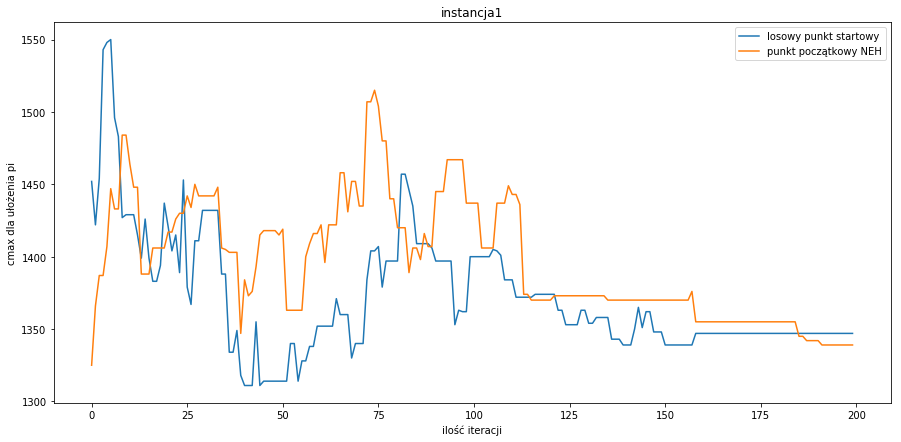

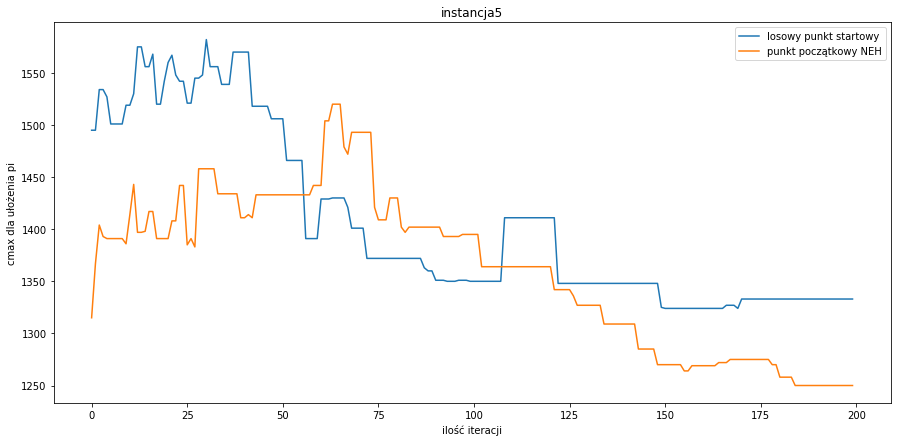

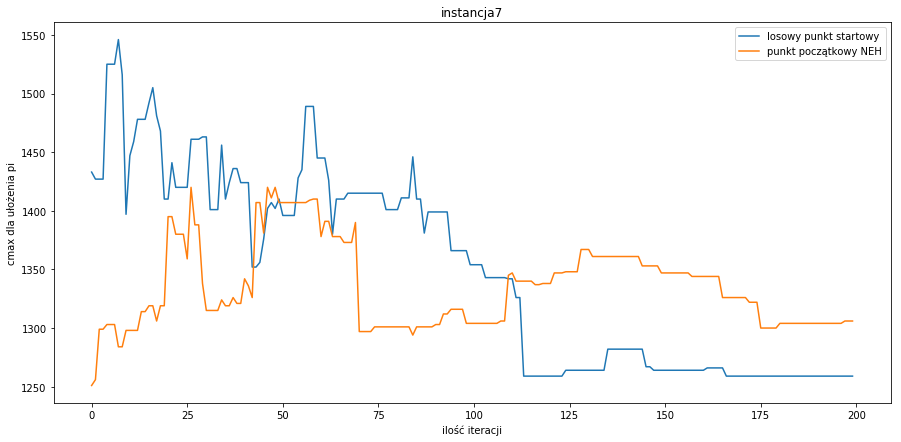

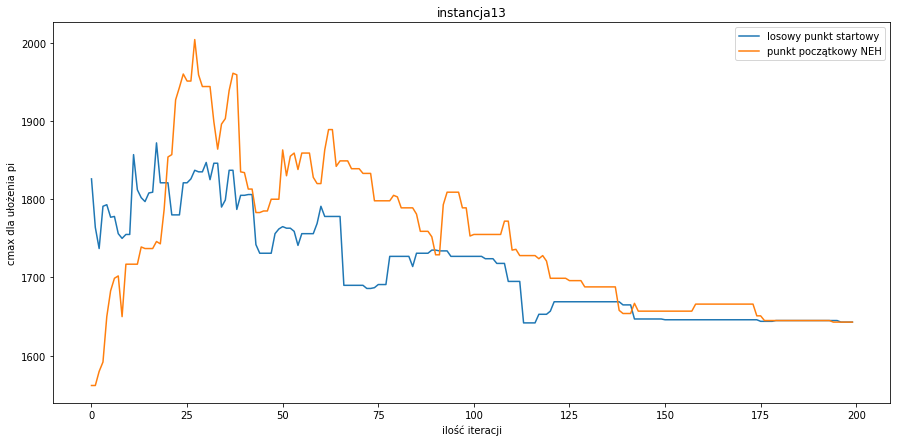

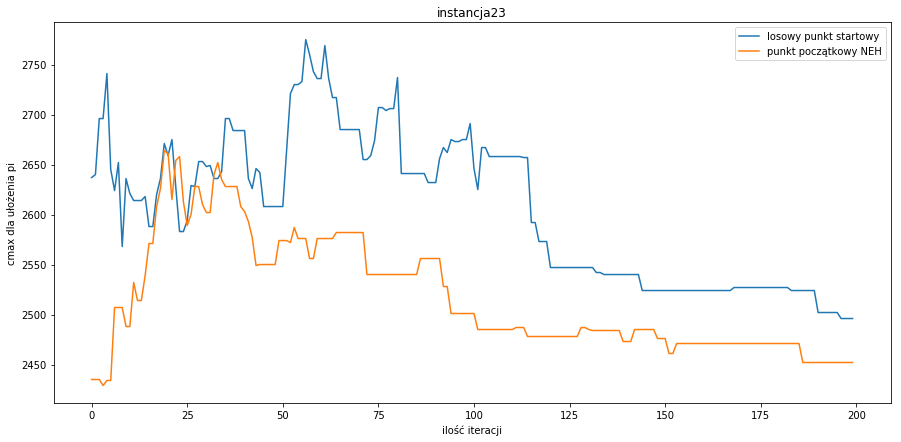

...

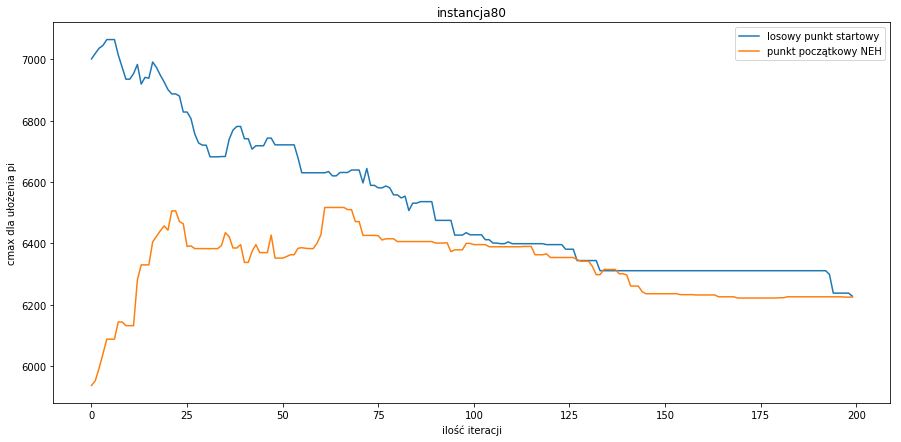

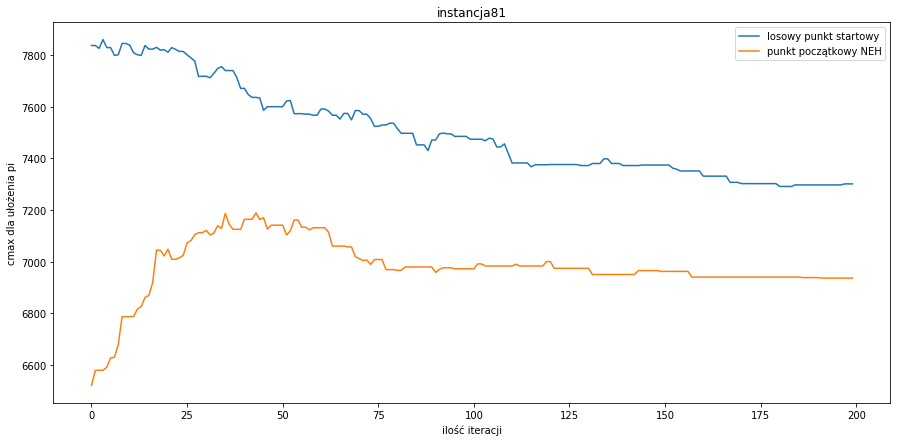

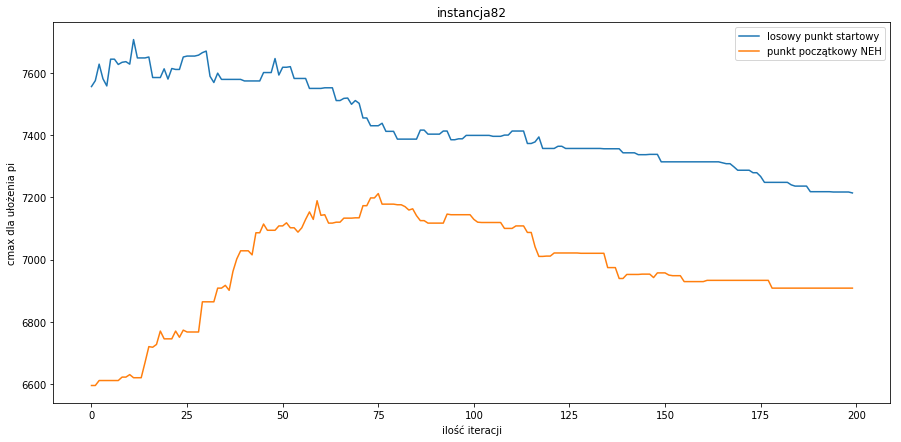

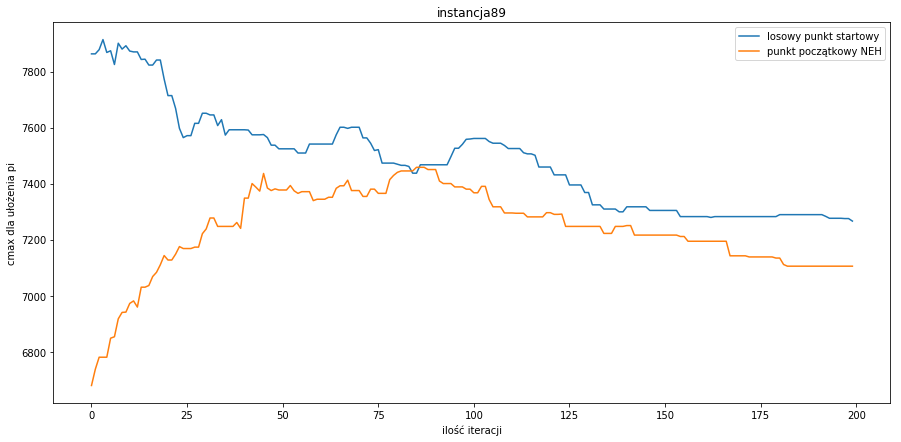

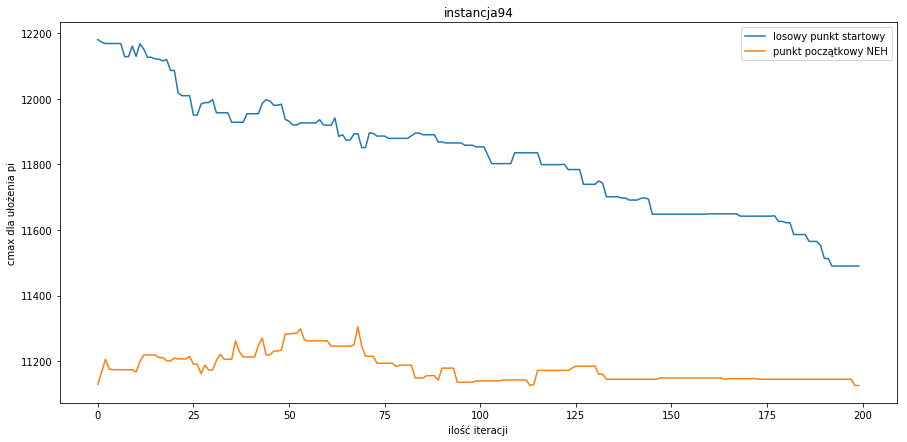

Średnia róznica wynosiła: 123.556


In [7]:
import time
from schedule import Schedule
from simulated_annealing import annealing
from random import randint
import plotly.plotly as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot
from plotly.graph_objs import *
init_notebook_mode()
 

seed(370773)

rnd_instances = []
for i in range(5):
    rnd_instances.append(randint(1,20))
for i in range(5):
    rnd_instances.append(randint(21,50))
for i in range(5):
    rnd_instances.append(randint(51,80))
for i in range(5):
    rnd_instances.append(randint(81,100))

rnd_instances = list(set(rnd_instances))
rnd_instances.sort()
    
schdl = Schedule()

iterations_tab = [200]
iterations = []
instances = []
s1_cmax = []
s2_cmax = []
min_cmax = []
dif = []
tab_data = [instances, iterations, s1_cmax, s2_cmax, dif]

desc = ['Instancja', 'Liczba iteracji', 'Cmax dla neutralnej kolejności', 'Cmax dla kolejności uzyskanej przez NEH', 'Różnica (Neutralna - NEH)']

for j in iterations_tab:
    for instance in rnd_instances:
        instances.append(instance)

        schdl.load_from_file("ta" + str(instance))
        cmax, ept1 = annealing(schdl, iterations=j, move="insert")
        s1_cmax.append(cmax)
        
        schdl.load_from_file("ta" + str(instance))
        schdl.basic_neh()
        cmax, ept2 = annealing(schdl, iterations=j, move="insert")
        s2_cmax.append(cmax)
        
        for k in range(len(instances)):
            minim = min(s1_cmax[k],s2_cmax[k])
            roz=s1_cmax[k]-s2_cmax[k]
        dif.append(roz)
        min_cmax.append(minim)
        
        iterations.append(j)
        plt.title("instancja"+str(instance))
        plt.xlabel("ilość iteracji")
        plt.ylabel("cmax dla ułożenia pi")
        plt.plot(ept1, label="losowy punkt startowy")
        plt.plot(ept2, label="punkt początkowy NEH")
        plt.legend()
        plt.show()
        
roznica = (sum(dif)/len(instances))
trace = go.Table(
    header=dict(values=desc),
    cells=dict(values=tab_data,
               fill = dict(color=['rgb(245,245,245)','rgb(245,245,245)',#unique color for the first column
                                            
                                ['rgba(0,250,0, 0.8)' if s1_cmax[k]==min_cmax[k] else 'rgb(245,245,245)' for k in range(len(instances))],
                                ['rgba(0,250,0, 0.8)' if s2_cmax[k]==min_cmax[k] else 'rgb(245,245,245)' for k in range(len(instances))],
                                 'rgb(245,245,245)']
                          )
              )
)



layout = Layout(
    showlegend=False,
    height=900,
    width=700,
    )

data = [trace]
fig = dict(data=data, layout=layout)
iplot(fig)

print("Średnia róznica wynosiła: " + str("{0:.3f}".format(roznica)))

W zdecydowanej większości przypadków optymalny wynik uzyskano, jako rozwiązanie startowe wykorzystując kolejność uzyskaną przy pomocy algorytmu NEH jednak zazwyczaj był on i tak nielepszy niż czysty algorytm NEH. Wartości Cmax dla tej kolejności były znacznie mniejsze niż dla kolejności neutralnej.

# Badania dotyczące wykonywanego ruchu

Przeprowadzono badania porównujące wersję wcześniejszą z wersją, w której odrzucane jest prawdopodobieństwo równe 1 dla nowych lepszych rozwiązań.

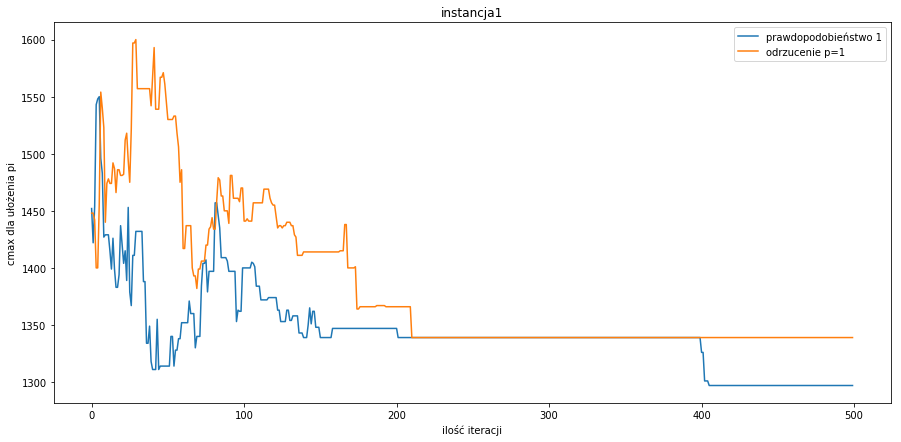

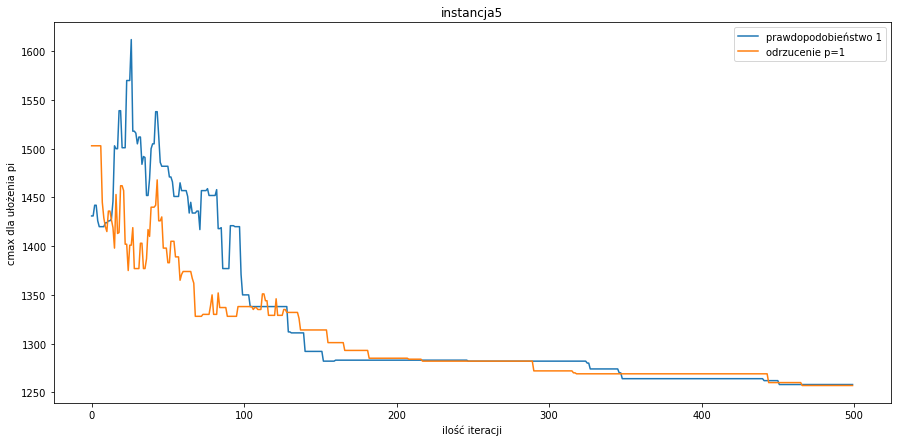

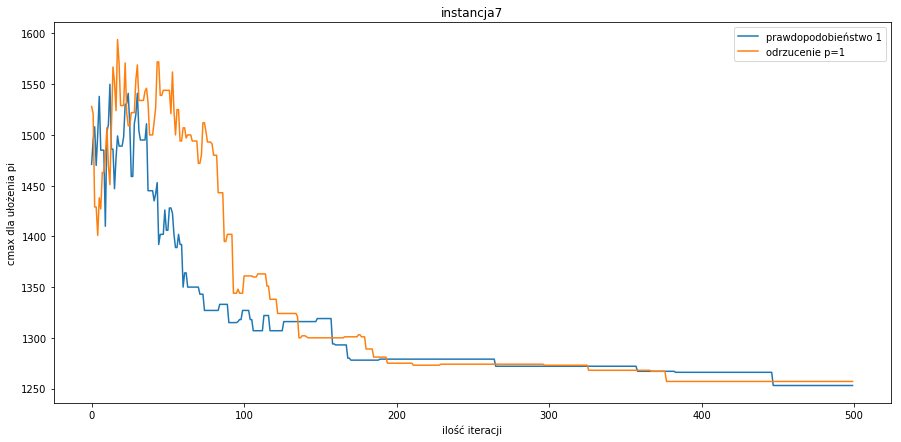

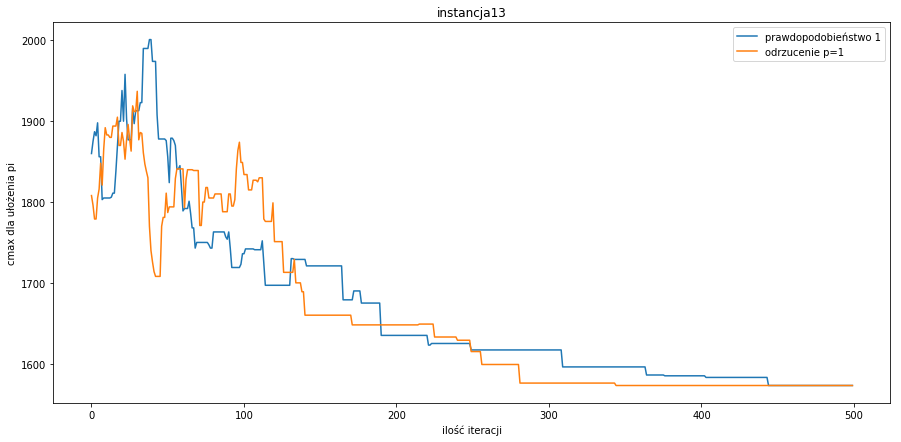

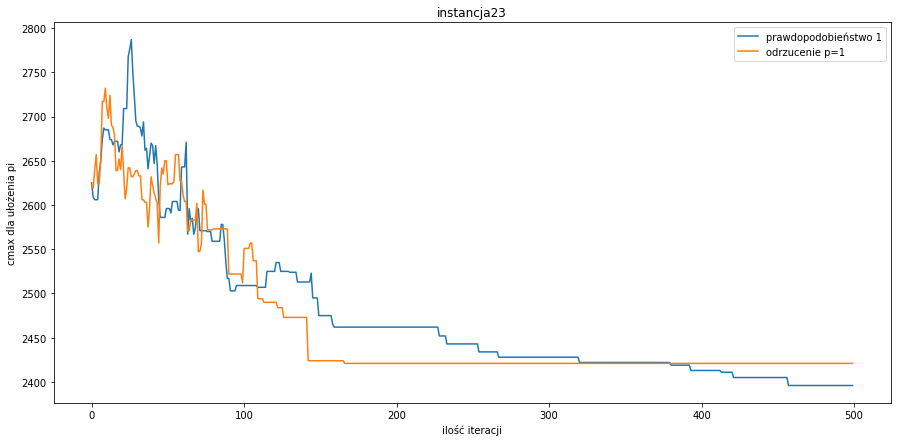

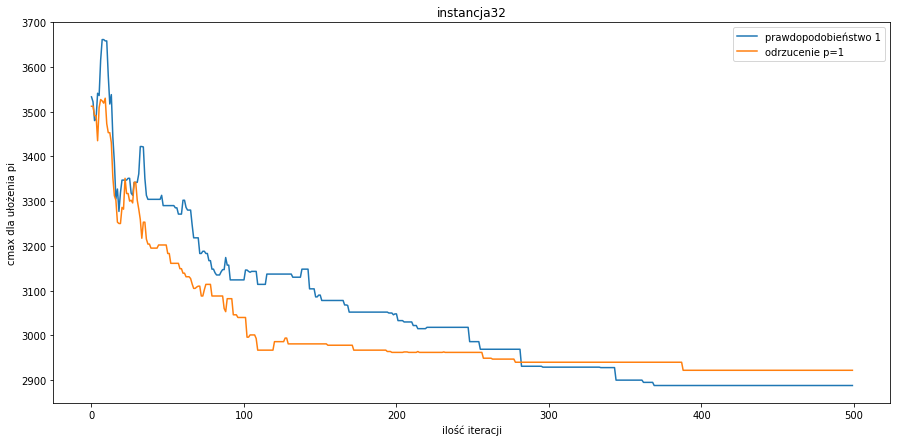

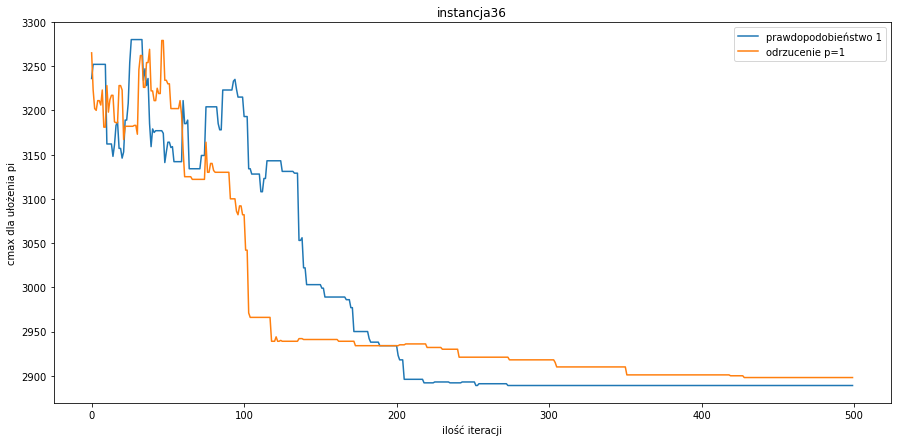

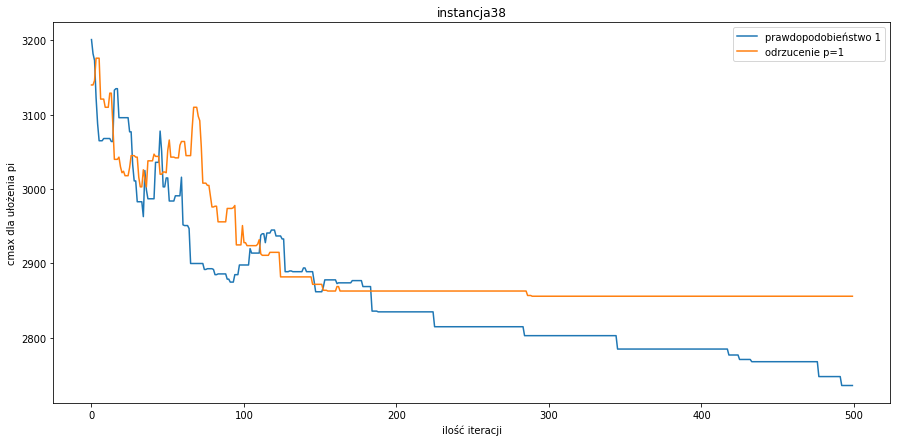

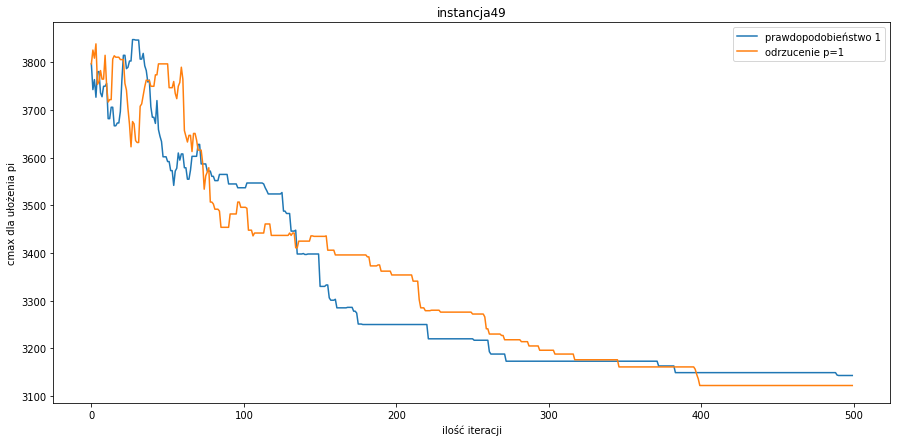

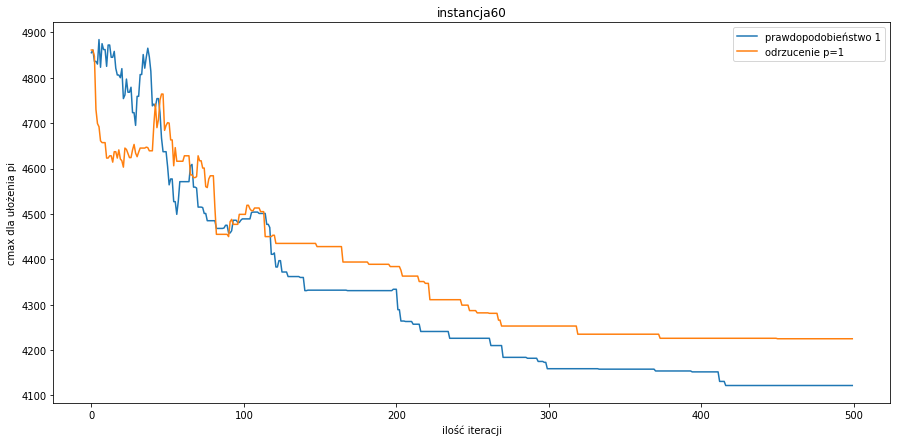

OverflowError: math range error

In [8]:
import matplotlib.pyplot as plt
%matplotlib inline
import time
from schedule import Schedule
from simulated_annealing import *
from random import randint, seed
import plotly.plotly as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot
from plotly.graph_objs import *
init_notebook_mode()

plt.rcParams['figure.figsize'] = [15, 7]

seed(370773)

rnd_instances = []
for i in range(5):
    rnd_instances.append(randint(1,20))
for i in range(5):
    rnd_instances.append(randint(21,50))
for i in range(5):
    rnd_instances.append(randint(51,80))
for i in range(5):
    rnd_instances.append(randint(81,100))

rnd_instances = list(set(rnd_instances))
rnd_instances.sort()
    
schdl = Schedule()

iterations_tab = [500]
iterations = []
instances = []
r1_cmax = []
r2_cmax = []
min_cmax = []
dif = []
tab_data = [instances, iterations, r1_cmax, r2_cmax, dif]

desc = ['Instancja', 'Liczba iteracji', 'Wersja pierwotna', 'Odrzucanie prawdopodobieństwa 1', 'Różnica (Pierwotna - Druga)']

for j in range(1):
    for instance in rnd_instances:
        instances.append(instance)

        schdl.load_from_file("ta" + str(instance))
        cmax, ept1 = annealing(schdl, iterations=iterations_tab[-1], move="insert")
        r1_cmax.append(cmax)
        
        schdl.load_from_file("ta" + str(instance))
        cmax, ept2 = annealing_prob(schdl, iterations=iterations_tab[-1], move="insert")
        r2_cmax.append(cmax)
        
        for k in range(len(instances)):
            minim = min(r1_cmax[k],r2_cmax[k])
            roz=r1_cmax[k]-r2_cmax[k]
        dif.append(roz)
        min_cmax.append(minim)
        
        iterations.append(iterations_tab[-1])
        
        plt.title("instancja"+str(instance))
        plt.xlabel("ilość iteracji")
        plt.ylabel("cmax dla ułożenia pi")
        plt.plot(ept1, label="prawdopodobieństwo 1")  
        plt.plot(ept2, label="odrzucenie p=1")

        plt.xlabel("ilość iteracji")
        plt.ylabel("cmax dla ułożenia pi")
        plt.legend()

        plt.show()

roznica = (sum(dif)/len(instances))
trace = go.Table(
    header=dict(values=desc),
    cells=dict(values=tab_data,
               fill = dict(color=['rgb(245,245,245)','rgb(245,245,245)',#unique color for the first column
                                            
                                ['rgba(0,250,0, 0.8)' if r1_cmax[k]==min_cmax[k] else 'rgb(245,245,245)' for k in range(len(instances))],
                                ['rgba(0,250,0, 0.8)' if r2_cmax[k]==min_cmax[k] else 'rgb(245,245,245)' for k in range(len(instances))],
                                 'rgb(245,245,245)']
                          )
              )
)

layout = Layout(
    showlegend=False,
    height=900,
    width=800,
    )

data = [trace]
fig = dict(data=data, layout=layout)
iplot(fig)

print("Średnia róznica wynosiła: " + str("{0:.3f}".format(roznica)))

Uzyskano niewielkie różnice, przez co nie można było jednoznacznie ocenić, które z podejść uznać za lepsze. Czasami minimalnie zwyciężała wersja pierwotna, a czasami wersja z odrzucaniem prawdopodobieństwa, więc oba podejścia dały zbliżony rezultat.

Przeprowadzono także badania porównujące wersję pierwotną z wersją, w której rozważane są wyłącznie rozwiązania, których Cmax jest różny od wartości Cmax obecnego rozwiązania.

In [9]:
import time
from schedule import Schedule
from simulated_annealing import *
from random import randint
import plotly.plotly as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot
from plotly.graph_objs import *
init_notebook_mode()
 
seed(370773)

rnd_instances = []
for i in range(5):
    rnd_instances.append(randint(1,20))
for i in range(5):
    rnd_instances.append(randint(21,50))
for i in range(5):
    rnd_instances.append(randint(51,80))
for i in range(5):
    rnd_instances.append(randint(81,100))

rnd_instances = list(set(rnd_instances))
rnd_instances.sort()
    
schdl = Schedule()

iterations_tab = [5, 10, 20, 30, 50, 75, 100, 200, 300, 400, 500, 700, 1000, 1200, 1500, 1700, 2000]
iterations = []
instances = []
r1_cmax = []
r2_cmax = []
min_cmax = []
dif = []
tab_data = [instances, iterations, r1_cmax, r2_cmax, dif]

desc = ['Instancja', 'Liczba iteracji', 'Wersja pierwotna', 'Cmax różny od obecnego', 'Różnica (Pierwotna - Druga)']

for j in range(5):
    for instance in rnd_instances:
        instances.append(instance)

        schdl.load_from_file("ta" + str(instance))
        cmax, ept = annealing(schdl, iterations=iterations_tab[j], move="insert")
        r1_cmax.append(cmax)
        
        schdl.load_from_file("ta" + str(instance))
        cmax, ept = annealing_cmax(schdl, iterations=iterations_tab[j], move="insert")
        r2_cmax.append(cmax)
        
        for k in range(len(instances)):
            minim = min(r1_cmax[k],r2_cmax[k])
            roz=r1_cmax[k]-r2_cmax[k]
        dif.append(roz)
        min_cmax.append(minim)
        
        iterations.append(iterations_tab[j])
        
roznica = (sum(dif)/len(instances))
trace = go.Table(
    header=dict(values=desc),
    cells=dict(values=tab_data,
               fill = dict(color=['rgb(245,245,245)','rgb(245,245,245)',#unique color for the first column
                                            
                                ['rgba(0,250,0, 0.8)' if r1_cmax[k]==min_cmax[k] else 'rgb(245,245,245)' for k in range(len(instances))],
                                ['rgba(0,250,0, 0.8)' if r2_cmax[k]==min_cmax[k] else 'rgb(245,245,245)' for k in range(len(instances))],
                                 'rgb(245,245,245)']
                          )
              )
)

layout = Layout(
    showlegend=False,
    height=900,
    width=700,
    )

data = [trace]
fig = dict(data=data, layout=layout)
iplot(fig)

print("Średnia róznica wynosiła: " + str("{0:.3f}".format(roznica)))

Średnia róznica wynosiła: 8.244


W tym wypadku lepsza okazała się wersja pierwotna, ale różnica nie była znacząca. Optymalne rozwiązania rozkładały się dość równomiernie, jednak różnica wartości poszczególnych Cmax przeważyła na korzyść wersji wykorzystywanej na początku.

# Porównanie najlepszej wersji symulowanego wyżarzania z algorytmem NEH

Porównano najlepszą wersję symulowanego wyżarzania z algorytmem NEH z poprzednich zajęć. Jako parametry dla symulowanego wyżarzania przyjęto temperaturę równą 100, ruch typu insert oraz wykorzystano alternatywną funkcję schładzania. Jako algorytm NEH przyjęto algorytm z usprawnionym obliczaniem Cmax.

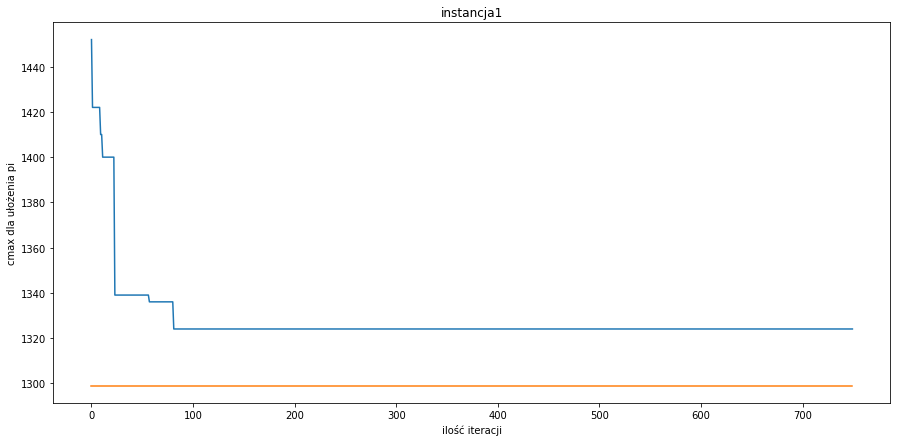

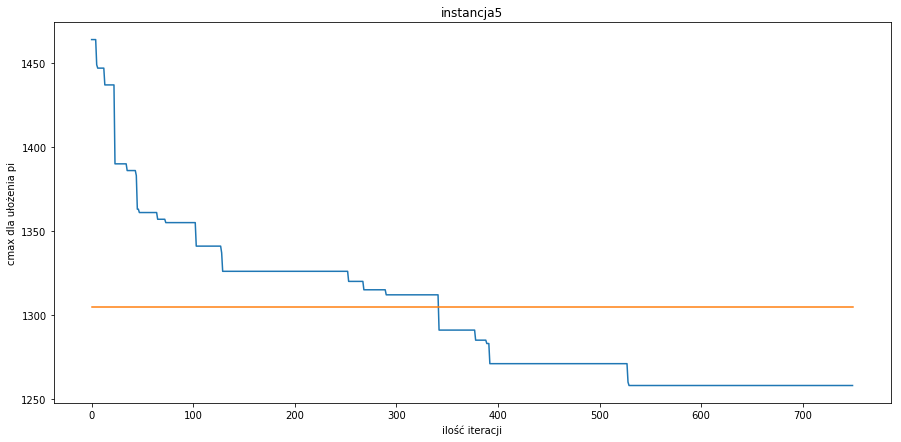

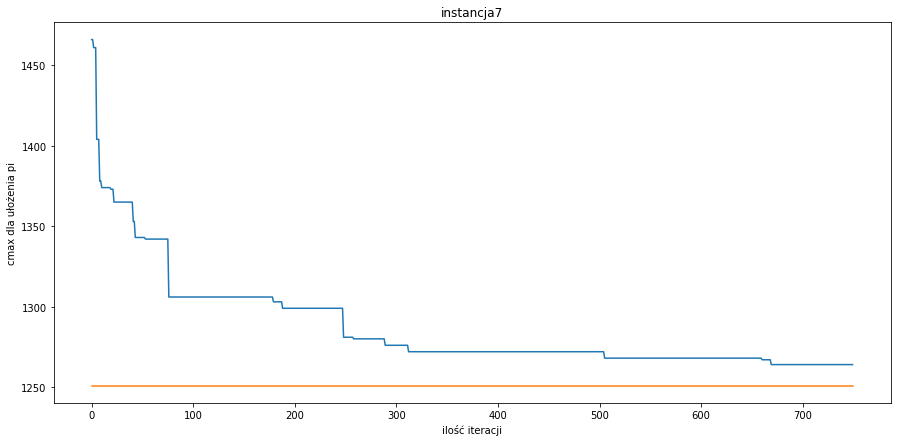

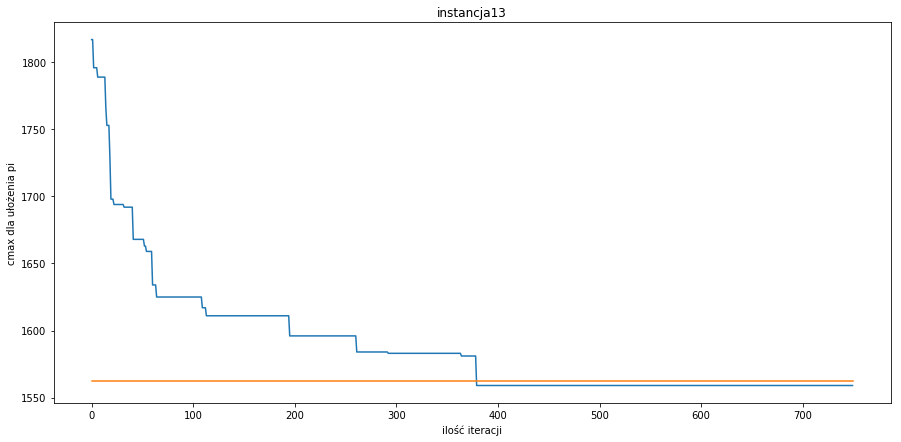

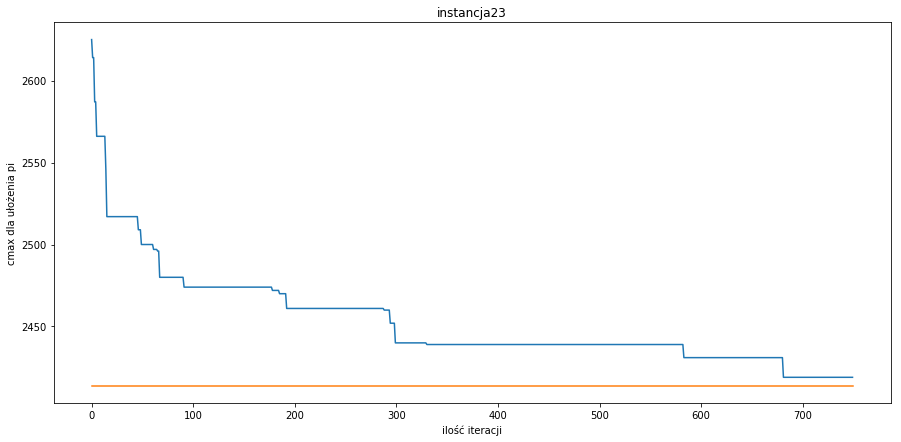

...

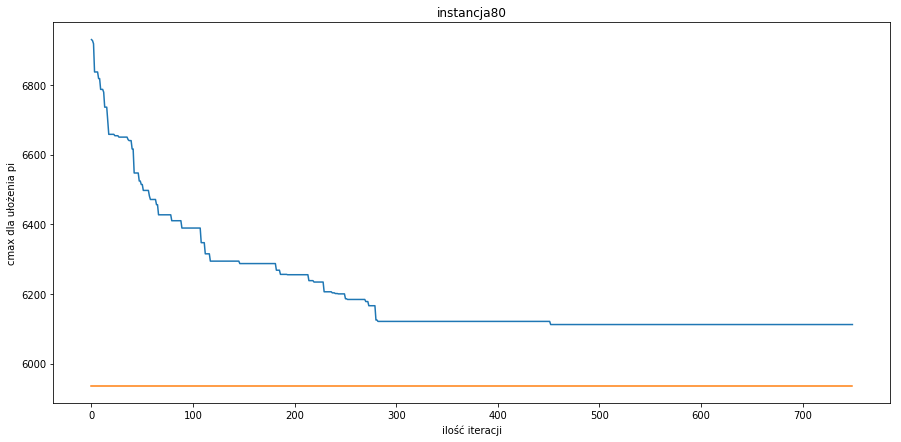

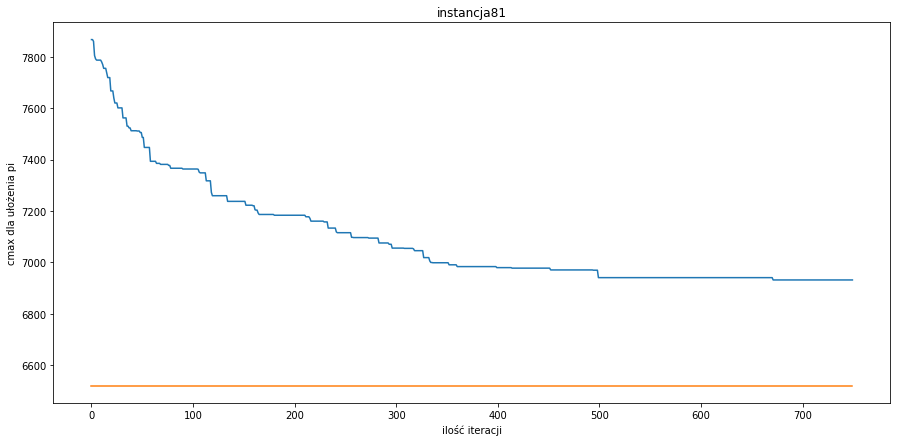

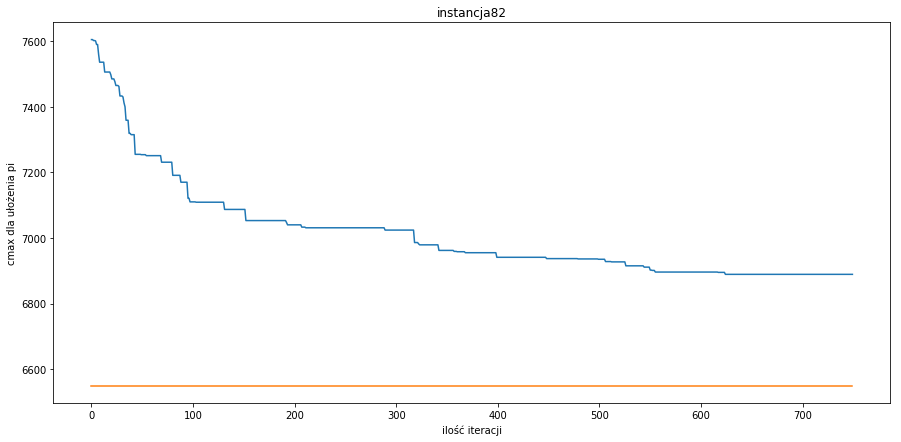

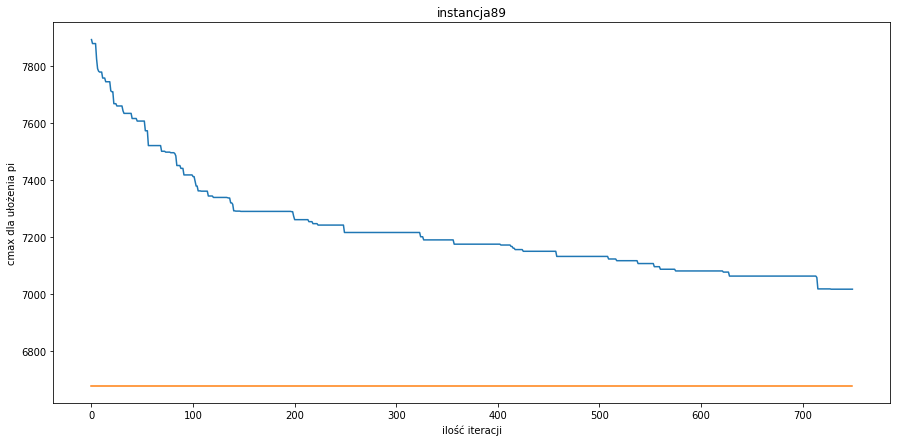

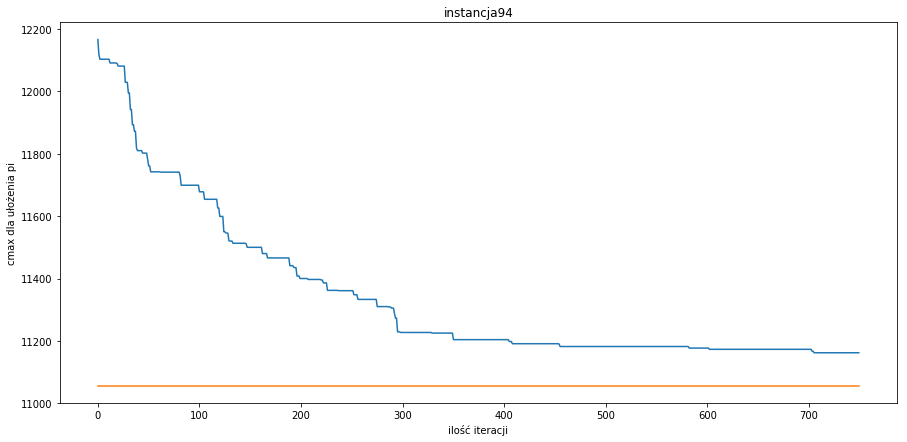

Średnia róznica wynosiła: 120.889


In [10]:
import time
from schedule import Schedule
from simulated_annealing import *
from random import randint, seed
import plotly.plotly as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot
from plotly.graph_objs import *
init_notebook_mode()
 
plt.rcParams['figure.figsize'] = [15, 7]

seed(370773)

rnd_instances = []
for i in range(5):
    rnd_instances.append(randint(1,20))
for i in range(5):
    rnd_instances.append(randint(21,50))
for i in range(5):
    rnd_instances.append(randint(51,80))
for i in range(5):
    rnd_instances.append(randint(81,100))

rnd_instances = list(set(rnd_instances))
rnd_instances.sort()
    
schdl = Schedule()

iterations_tab = [750]
iterations = []
instances = []
r1_cmax = []
r2_cmax = []
min_cmax = []
sa_time = []
neh_time = []
dif = []
tab_data = [instances, iterations, r1_cmax, r2_cmax, sa_time, neh_time, dif]

desc = ['Instancja', 'Liczba iteracji', 'Symulowane wyżarzanie', 'Algorytm NEH', 'Czas SA', 'Czas NEH', 'Różnica (SA-NEH)']

for j in range(len(iterations_tab)):
    for instance in rnd_instances:
        instances.append(instance)

        schdl.load_from_file("ta" + str(instance))
        start = time.time()
        cmax, ept = annealing(schdl, u=0.8, temp=100, iterations=iterations_tab[j], move="insert", op="alternative")
        end = time.time()
        sa_time.append("{0:.7f}".format(end-start))
        r1_cmax.append(cmax)
        
        schdl.load_from_file("ta" + str(instance))
        start = time.time()
        schdl.basic_neh()
        end = time.time()
        neh_time.append("{0:.7f}".format(end-start))
        r2_cmax.append(schdl.cmax())
        
        for k in range(len(instances)):
            minim = min(r1_cmax[k],r2_cmax[k])
            roz=r1_cmax[k]-r2_cmax[k]
        dif.append(roz)
        min_cmax.append(minim)
        
        iterations.append(iterations_tab[j])
    
        plt.title("instancja"+str(instance))
        plt.xlabel("ilość iteracji")
        plt.ylabel("cmax dla ułożenia pi")
        plt.plot(ept)
        plt.plot([r2_cmax[-1]]*iterations_tab[-1])
        plt.show()
    
roznica = (sum(dif)/len(instances))
trace = go.Table(
    header=dict(values=desc),
    cells=dict(values=tab_data,
               fill = dict(color=['rgb(245,245,245)','rgb(245,245,245)',#unique color for the first column
                                            
                                ['rgba(0,250,0, 0.8)' if r1_cmax[k]==min_cmax[k] else 'rgb(245,245,245)' for k in range(len(instances))],
                                ['rgba(0,250,0, 0.8)' if r2_cmax[k]==min_cmax[k] else 'rgb(245,245,245)' for k in range(len(instances))],
                                 'rgb(245,245,245)','rgb(245,245,245)','rgb(245,245,245)']
                          )
              )
)

layout = Layout(
    showlegend=False,
    height=900,
    width=700,
    )

data = [trace]
fig = dict(data=data, layout=layout)
iplot(fig)

print("Średnia róznica wynosiła: " + str("{0:.3f}".format(roznica)))

Lepszy okazał się algorytm NEH, który dla większych instancji uzyskał dużo mniejsze wyniki. Przy małych instancjach różnice obu algorytmów były niewielkie, jednak im dalej, tym bardziej rosły na korzyść algorytmu NEH. Początkowo czas symulowanego wyżarzania był dłuższy niż dla algorytmu NEH, ale dla dużych instancji sytuacja się odwróciła i to algorytm NEH stał się tym wolniejszym.

# Dodatkowa modyfikacja


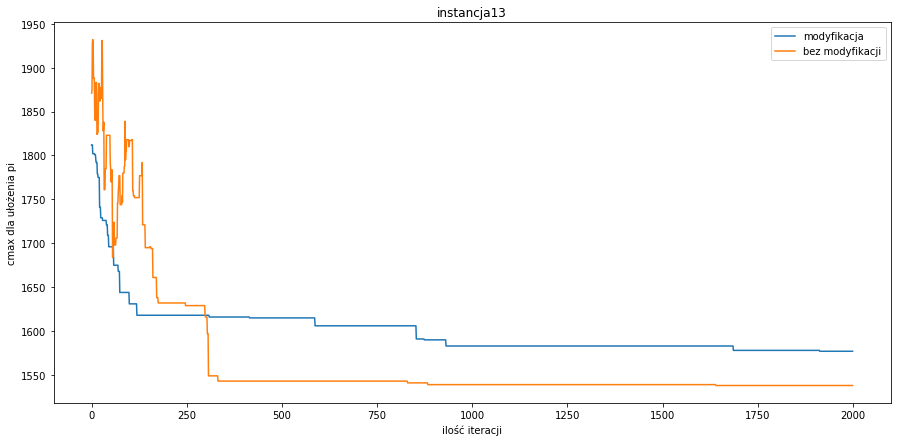

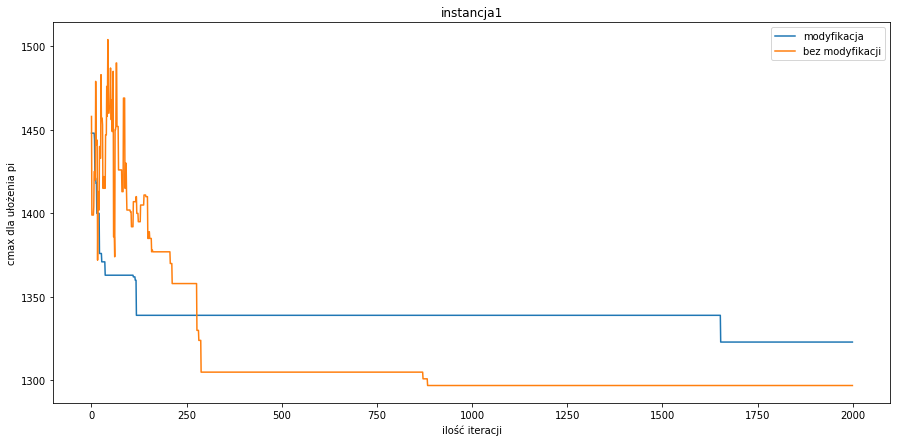

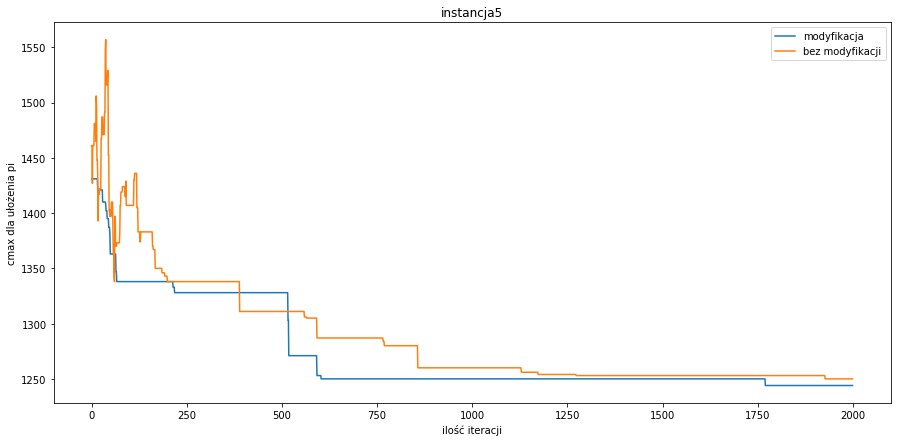

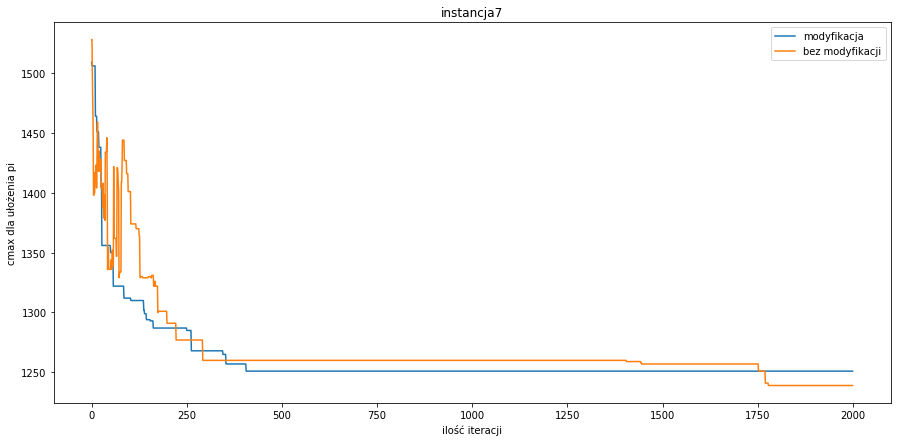

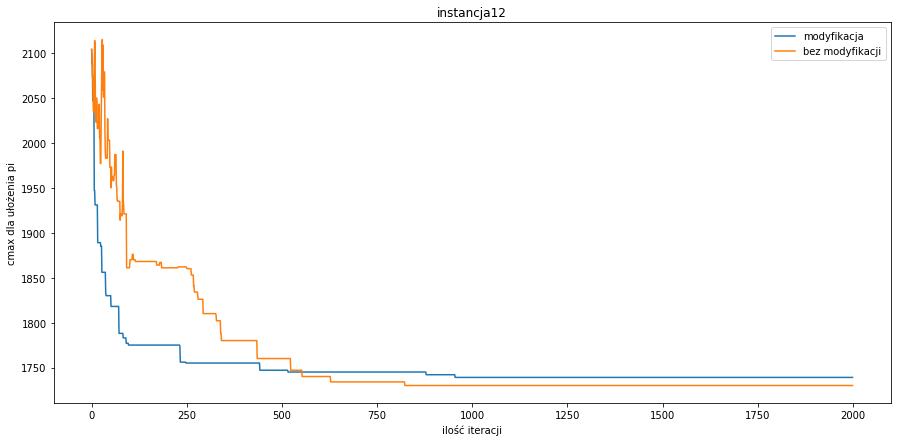

...

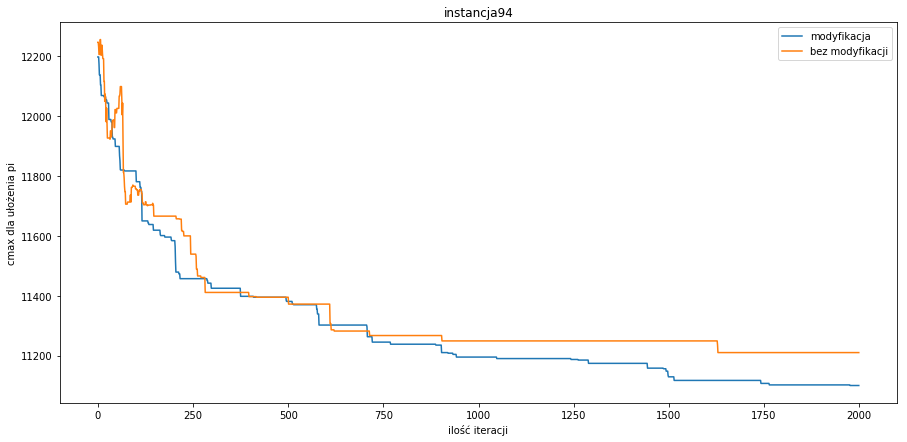

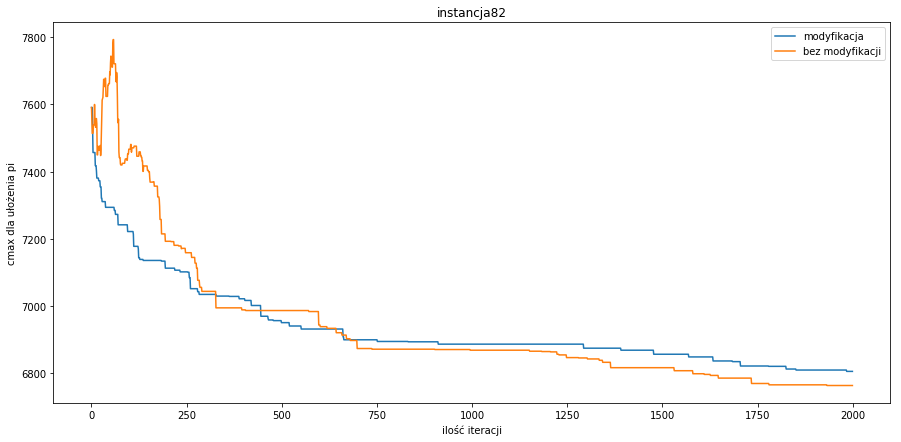

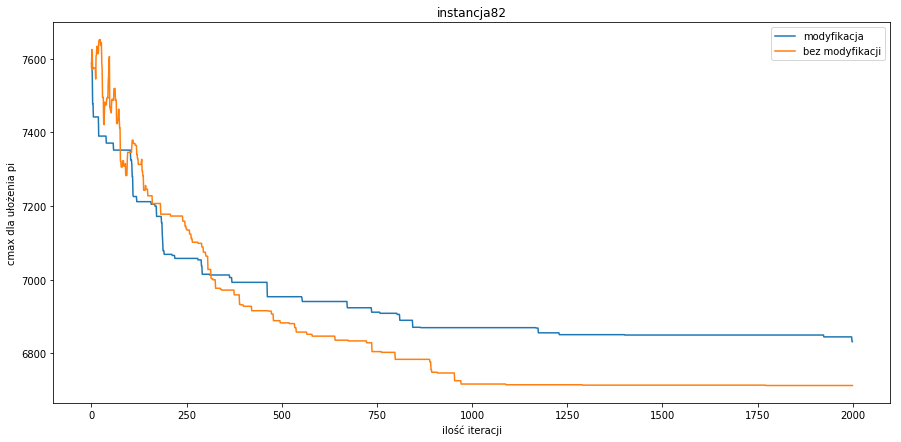

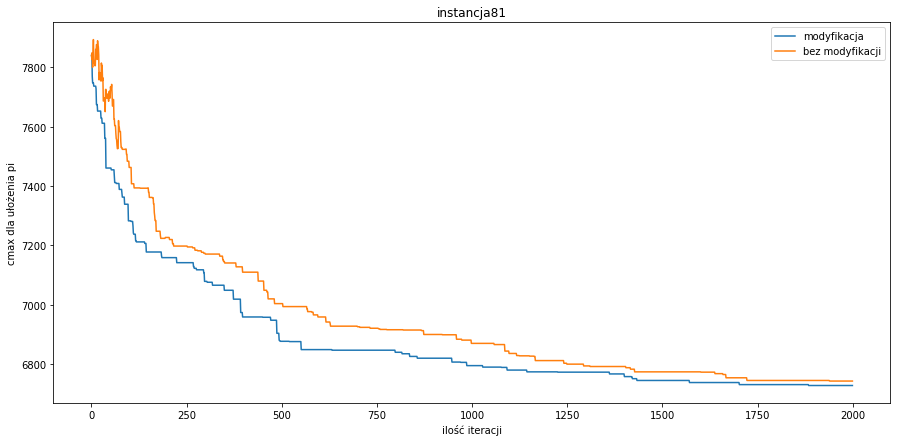

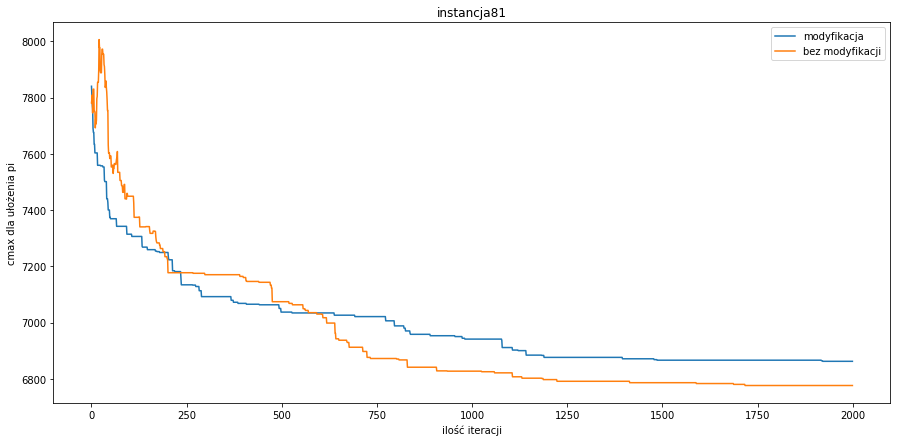

In [14]:
from schedule import Schedule
from simulated_annealing import *
import matplotlib.pyplot as plt
%matplotlib inline
from random import seed
seed(370773)
plt.rcParams['figure.figsize'] = [15, 7]

instance = randint(20,50)

schdl = Schedule()

rnd_instances = []
for i in range(5):
    rnd_instances.append(randint(1,20))
for i in range(5):
    rnd_instances.append(randint(21,50))
for i in range(5):
    rnd_instances.append(randint(51,80))
for i in range(5):
    rnd_instances.append(randint(81,100))

iterations_tab = [10, 50, 100, 200, 1000, 2000]
    
iterations = 2000
u=0.98
iterations_tab =[]
instances = []
basic_cmax = []
mod_cmax = []

tab_data = [instances, iterations_tab, basic_cmax, mod_cmax]

desc = ['Instancja', 'Liczba iteracji', 'Cmax podstawowe', 'Cmax modyfikacji']


for instance in rnd_instances:

    schdl.load_from_file("ta"+str(instance))
    schedule_lenght = len(schdl.joblist)
    cmax_mod = []
    temp = 0
    for i in range(schdl.number_of_jobs):
        for j in range(schdl.number_of_machines):
            temp += (1/5) * schdl.joblist[i].time[j]
            temp = temp/(schdl.number_of_jobs*schdl.number_of_machines)
    
    for i in range(iterations):

        tmp_schdl = schdl.__copy__()
        swap(tmp_schdl, schedule_lenght)
        if tmp_schdl.cmax() < schdl.cmax():
            schdl = tmp_schdl
        else:
            prob = math.exp((schdl.cmax() - tmp_schdl.cmax())/temp)
            if random() < prob:
                schdl = tmp_schdl

        cmax_mod.append(schdl.cmax())
        temp = u * temp


    
    schdl = Schedule()
    schdl.load_from_file("ta"+str(instance))

    temp = 100
    iterations = 2000
    u=0.98
    cmax_nmod =[]

    schedule_lenght = len(schdl.joblist)
    for i in range(iterations):
        tmp_schdl = schdl.__copy__()
        swap(tmp_schdl, schedule_lenght)
        if tmp_schdl.cmax() < schdl.cmax():
            schdl = tmp_schdl
        else:
            prob = math.exp((schdl.cmax() - tmp_schdl.cmax())/temp)
            if random() < prob:
                schdl = tmp_schdl

        cmax_nmod.append(schdl.cmax())
        temp = u * temp

    plt.title("instancja"+str(instance))
    plt.xlabel("ilość iteracji")
    plt.ylabel("cmax dla ułożenia pi")
    plt.plot(cmax_mod, label="modyfikacja")
    plt.plot(cmax_nmod, label="bez modyfikacji")
    plt.legend()
    plt.show()
    
    for iterations_num in iterations_tab:
        basic_cmax.append(cmax_nmod[iterations_num-1])
        mod_cmax.append(cmax_mod[iterations_num-1])
        iterations.append(iterations_num)
        instances.append(instance)        

    
layout = Layout(
showlegend=False,
height=900,
width=700,
)


Modyfikacja polegała na wyznaczaniu temperatury początkowej na podstawie wzoru $T0 = k* \sum_{i=1}^n \sum_{j=1}^m p_{ji}/(m*n)$, gdzie n i m to kolejno liczba zadań i liczba maszyn. Wprowadzenie tej modyfikacji pokazało, jak duża była temperatura początkowa w poprzednich badaniach, modyfikacja pozwala szybko znaleźć dobre rozwiązanie, ale stwarza ryzyko znalezienia się funkcji w lokalnym minimum i dla większej liczby iteracji okazuje się gorsze.